#FINAL PROJECT

Integrantes de equipo:
1. Alfonso Murrieta Villegas 
2. C. Nathaniel Ceballos Equihua
3. Felipe de Jesús Solano González
4. Juan Muñoz Marbán


# 1. Libraries and dataset importation

Se descarga únicamente la carpeta relacionada al proyecto del repositorio, utilizando *subversion*. También se importan las bibliotecas utilizadas a lo largo del proyecto.

In [ ]:
!apt-get install subversion

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following additional packages will be installed:
  libapr1 libaprutil1 libserf-1-1 libsvn1
Suggested packages:
  db5.3-util libapache2-mod-svn subversion-tools
The following NEW packages will be installed:
  libapr1 libaprutil1 libserf-1-1 libsvn1 subversion
0 upgraded, 5 newly installed, 0 to remove and 37 not upgraded.
Need to get 2,237 kB of archives.
After this operation, 9,910 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/main amd64 libapr1 amd64 1.6.3-2 [90.9 kB]
Get:2 http://archive.ubuntu.com/ubuntu bionic/main amd64 libaprutil1 amd64 1.6.1-2 [84.4 kB]
Get:3 http://archive.ubuntu.com/ubuntu bionic/universe amd64 libserf-1-1 amd64 1.3.9-6 [44.4 kB]
Get:4 http://archive.ubuntu.com/ubuntu bionic/universe amd64 libsvn1 amd64 1.9.7-4ubuntu1 [1,183 kB]
Get:5 http://archive.ubuntu.com/ubuntu bionic/universe amd64 subversion amd64 1.9.7-4ubuntu1 

In [ ]:
!svn checkout https://github.com/aMurryFly/Pattern-Recognition.git/trunk/project
!svn update

A    project/dataset
A    project/dataset/test
A    project/dataset/test/t_1.png
A    project/dataset/test/t_2.png
A    project/dataset/test/t_3.png
A    project/dataset/test/t_4.png
A    project/dataset/test/t_5.png
A    project/dataset/test2
A    project/dataset/test2/1622138340.Thu.May.27_17_59_00.GMT.2021.morelos.c2.timex.png
A    project/dataset/test2/1622138460.Thu.May.27_18_01_00.GMT.2021.morelos.c2.timex.png
A    project/dataset/test2/1622138620.Thu.May.27_18_03_40.GMT.2021.morelos.c2.timex.png
A    project/dataset/test2/1622138800.Thu.May.27_18_06_40.GMT.2021.morelos.c2.timex.png
A    project/dataset/test2/1622138880.Thu.May.27_18_08_00.GMT.2021.morelos.c2.timex.png
A    project/dataset/test2/1622140900.Thu.May.27_18_41_40.GMT.2021.morelos.c2.timex.png
A    project/dataset/test2/1622142100.Thu.May.27_19_01_40.GMT.2021.morelos.c2.timex.png
A    project/dataset/test2/1622142280.Thu.May.27_19_04_40.GMT.2021.morelos.c2.timex.png
A    project/dataset/test2/1622142660.Thu.May.27_19_

In [ ]:
from matplotlib import pyplot as plt                # To plot images
from matplotlib import image as img                 # Matplotlib module for images
import numpy as np                                  # For array and math operations
import cv2                                          # Image manipulation, k-means
from google.colab.patches import cv2_imshow         # Display OpenCV images
from PIL import Image, ImageEnhance, ImageFilter    # Image manipulation, filters
import glob                                         # File reading
from numpy.random import seed                       # Seed for random number generation
from numpy.random import randint                    # Used to avoid singular matrixes for masked out space (beach and sky)

Previamente se realizó un muestreo aleatorio del drive que contenía todas las imágenes, además de la separaciónpara el entrenamiento y prueba teníendo la siguiente relación:

1. Train = 40 imágenes = 80%
2. Test = 10 imágenes = 20%

In [ ]:
test_images_dir = "/content/project/dataset/test2/"
train_images_dir = "/content/project/dataset/train2/"
general_mask = cv2.imread("/content/project/general_mask.png")

In [ ]:
test_images_list = glob.glob(test_images_dir + "/*")
test_images_list.sort()

In [ ]:
train_images_list = glob.glob(train_images_dir + "/*")
train_images_list.sort()

In [ ]:
# Function to plot a group of images

def plot_images(data, len_x, len_y, indexes):
  fig = plt.figure(figsize = (len_x, len_y)) 
  fig.subplots_adjust(left = 0, right = 5, bottom = 0, top = 4, hspace = 0.05, wspace = 0.05)
  j = 1
  for i in indexes:
    ax = fig.add_subplot(len_y, len_x, j, xticks = [], yticks = [])
    ax.imshow(data[i])
    j += 1
  plt.show()

###Training images

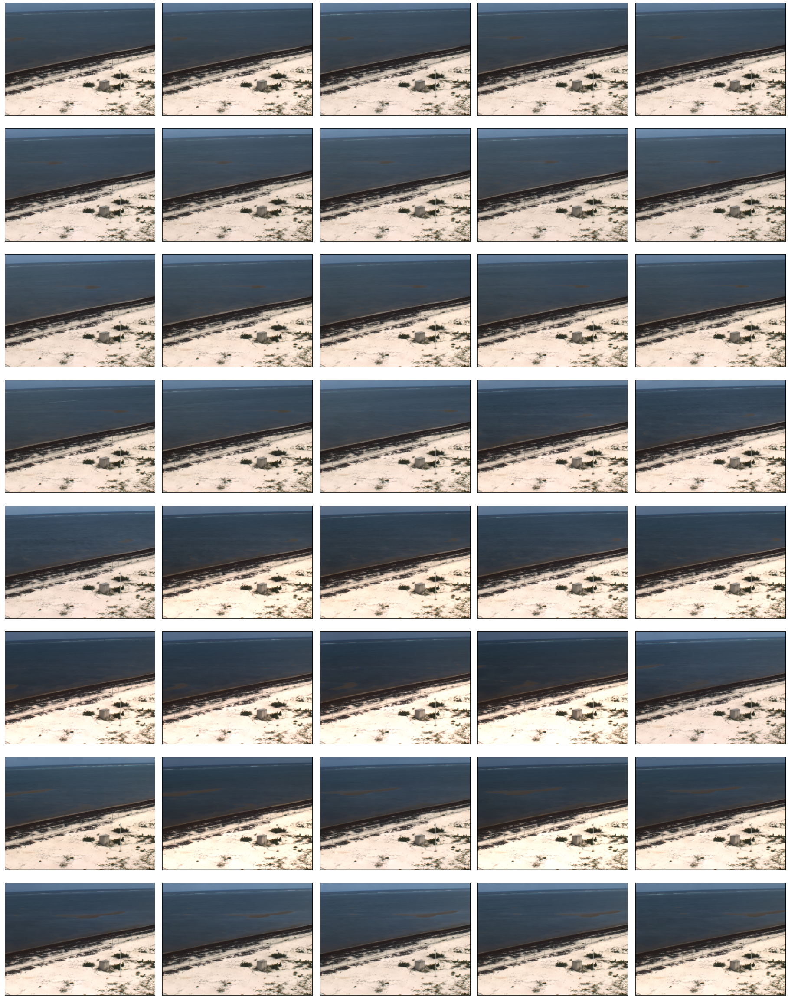

In [ ]:
train_images = []
for image in train_images_list:
  train_images.append(cv2.cvtColor(cv2.imread(image), cv2.COLOR_BGR2RGB))

plot_images(train_images, 5, 8, range(len(train_images)))

###Test images

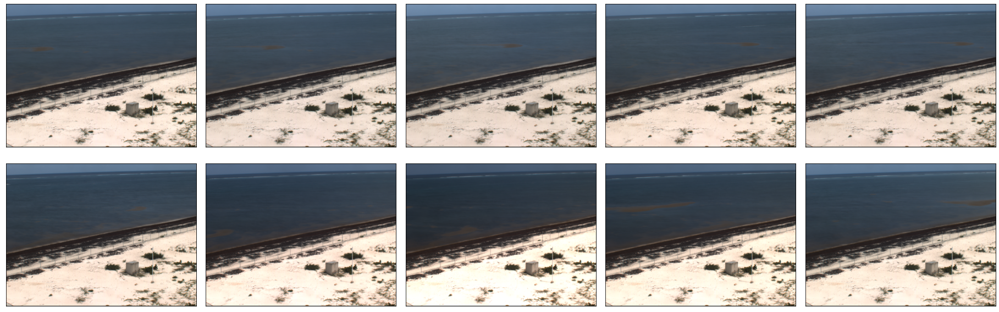

In [ ]:
test_images = []
for image in test_images_list:
  test_images.append(cv2.cvtColor(cv2.imread(image), cv2.COLOR_BGR2RGB))

plot_images(test_images, 5, 8, range(len(test_images)))

# 2. Data preprocessing

Se decidió, en primer lugar, utilizar una máscara en todas las imágenes (tanto de entrenamiento como de prueba) para descartar las zonas estáticas que son irrelevantes (el cielo y la playa), pues, al utilizar un clasificador bayesiano tomando como características el color (y, en este caso, también las coordenadas) de los píxeles, estas zonas agregan ruido. Al descartarlas, sólo se tiene que lidiar con los colores presentes en el agua del océano y los presentes en el sargazo. Para esto, entonces, estas zonas se reemplazan por píxeles negros, por lo que se identifican tres clases: sargazo, océano y fondo (compuesto por la playa y el cielo).

Por otro lado, se utilizaron ciertos filtros para manipular el color (o saturación), contraste y brillo de las imágenes, para resaltar las diferencias entre el color del sargazo y del agua, pues las imágenes originales tienen poco contraste. Lo relevante en este caso es identificar las zonas de sargazo, por lo que aplicar filtros para la etapa de procesamiento no perjudica el resultado (en este caso, lo beneficia).

Finalmente, también se aplica un filtro gaussiano, para facilitar la identificación de zonas.

###General mask

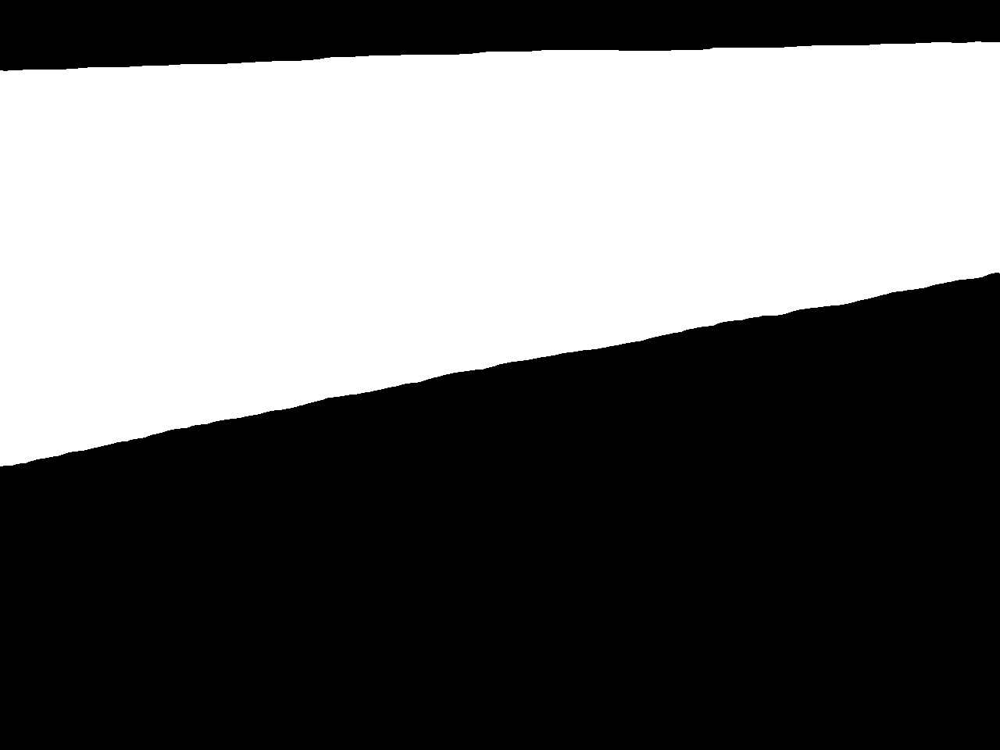

In [ ]:
initial_mask = cv2.cvtColor(general_mask, cv2.COLOR_BGR2GRAY)
cv2_imshow(initial_mask)

###Filters application

In [ ]:
# Function to apply color, contrast, brightness and blur filters for ease of processing

def applyFilters(image_list):
  filtered_images = []

  for image in image_list:
    pil_image = Image.open(image)
    filter_bright = ImageEnhance.Brightness(pil_image)
    filtered_image = filter_bright.enhance(1.8)
    filter_contrast = ImageEnhance.Contrast(filtered_image)
    filtered_image = filter_contrast.enhance(1.6)
    filter_sharp = ImageEnhance.Sharpness(filtered_image)
    filtered_image = filter_sharp.enhance(1.6)
    filter_color = ImageEnhance.Color(filtered_image)
    filtered_image = filter_color.enhance(2.5)
    pil_image_blur = filtered_image.filter(ImageFilter.GaussianBlur(radius = 3))
    opencvImage = cv2.cvtColor(np.array(pil_image_blur), cv2.COLOR_RGB2BGR) # Creates an image array with BGR values
    img = cv2.cvtColor(opencvImage, cv2.COLOR_BGR2RGB) # Transforms from BGR to RGB
    filtered_images.append(img)
  
  return filtered_images

In [ ]:
train_images_filtered = applyFilters(train_images_list)

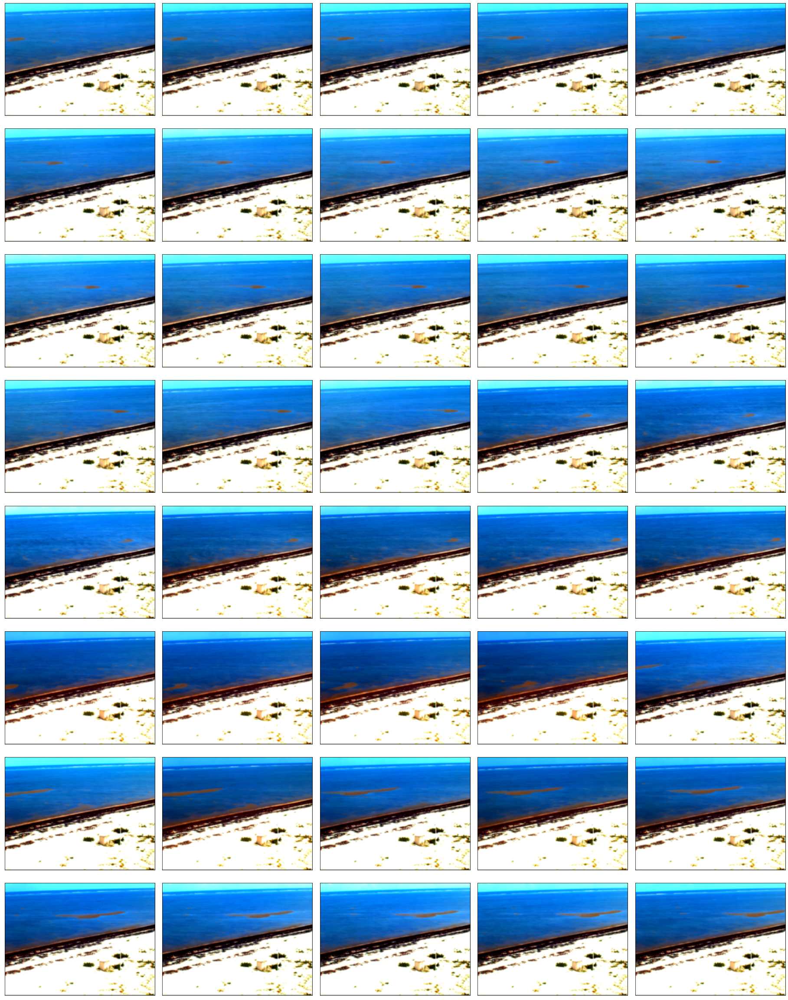

In [ ]:
plot_images(train_images_filtered, 5, 8, range(len(train_images_filtered)))

###General mask application to training images

In [ ]:
# Function to substitute the pixels discarded by the mask for black pixels in the images to be processed

def maskSustitution(image_list, mask, random = False):
  masked_images = []
  maskIdx = np.nonzero(mask == 0)

  if random:
    seed(0)

  for image in image_list:
    maskImg = image.copy()
    if random:
      maskImg[maskIdx[0], maskIdx[1]] = randint(0, 5, 3)
    else:
      maskImg[maskIdx[0], maskIdx[1]] = np.array([0, 0, 0])
    masked_images.append(maskImg)

  return masked_images

In [ ]:
train_images_firstmask = maskSustitution(train_images_filtered, initial_mask)

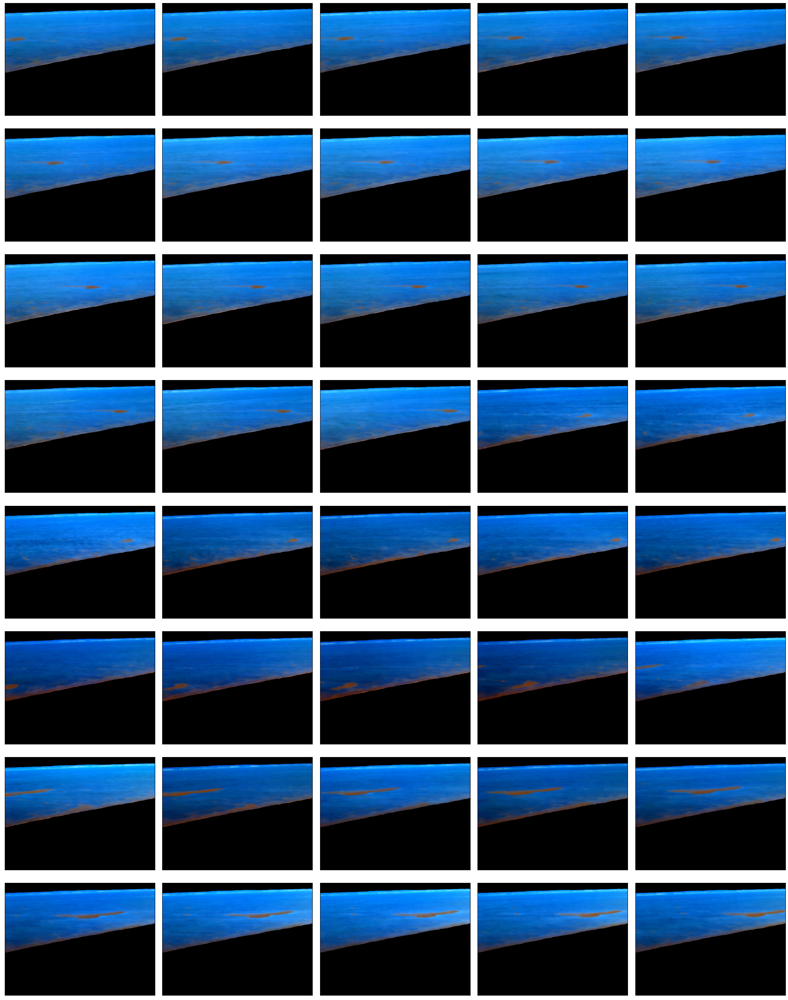

In [ ]:
plot_images(train_images_firstmask, 5, 8, range(len(train_images_firstmask)))

#3. Masks obtention using k-means

En este caso, en lugar de recortar las imágenes manualmente, se utiliza k-means para obtener las máscaras que definen al sargazo y al océano (por esto es que fue necesario aplicar los filtros mencionados anteriormente, para acentuar las diferencias entre los colores del sargazo y del agua). En este caso, los colores del sargazo tienen un mayor valor rojo (R) y menor azul (B), por lo que es posible determinar de forma automática qué colores corresponden al sargazo en cada imagen y qué colores no.

A partir de esta información, se generan las máscaras correspondientes al sargazo y al océano.

###K-means obtention

In [ ]:
# Function to obtain K-means from a list of images

def getKmeans(image_list, K, attempts):
  kmeans_images = []
  rgb_list = []

  for img in image_list:
    vectorized = img.reshape((-1, 3)) # Convert to a row*col x RGB matrix, this is, an array containing directly the RGB arrays (one per pixel in the image)
    vectorized = np.float32(vectorized) # Convert to float values, needed by OpenCV's k-means function
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0) # Define accuracy and max iterations for k-means algorithm
    # Compactness is how compact the clustering is, label is the index of the result colour for each pixel and center is an array of the obtained colour arrays
    compactness, label, center = cv2.kmeans(vectorized, K, None, criteria, attempts, cv2.KMEANS_PP_CENTERS)
    center = np.uint8(center) # Show obtained colours
    plt.imshow([center])
    plt.show()
    rgb = sorted(center, key=lambda x: x[0]) # Show sorted colours, from lowest R value to highest
    rgb = np.vstack(rgb)
    plt.imshow([rgb])
    plt.show()
    print(rgb) # Show RGB values from sorted colours
    rgb_list.append(rgb)
    res = center[label.flatten()] # Reconstruct image using label indexes and obtained colours
    result_image = res.reshape((img.shape)) # Reshape the obtained image to its original shape
    # Display original image and k-means image
    figure_size = 30
    plt.figure(figsize=(figure_size, figure_size))
    plt.subplot(1,2,1),plt.imshow(img)
    plt.title('Original Image'), plt.xticks([]), plt.yticks([])
    plt.subplot(1,2,2), plt.imshow(result_image)
    plt.title('Segmented Image when K = %i' % K), plt.xticks([]), plt.yticks([])
    plt.show()
    kmeans_images.append(result_image)

  return kmeans_images, rgb_list

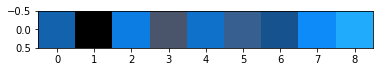

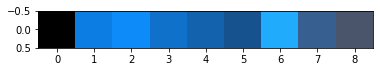

[[  0   0   0]
 [ 11 125 227]
 [ 12 139 249]
 [ 16 113 202]
 [ 19  98 174]
 [ 22  82 142]
 [ 33 171 253]
 [ 55  95 143]
 [ 74  85 108]]


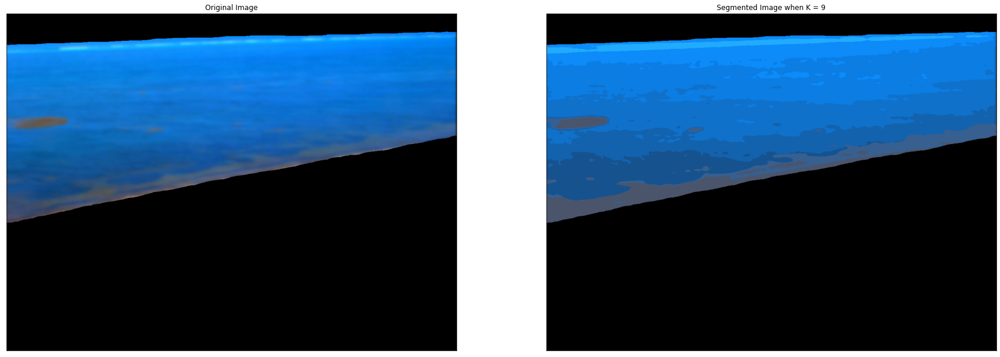

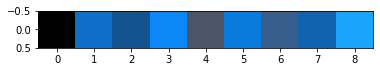

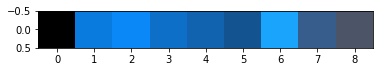

[[  0   0   0]
 [  9 123 223]
 [ 10 136 247]
 [ 14 111 200]
 [ 18  99 175]
 [ 19  83 144]
 [ 27 164 252]
 [ 55  93 140]
 [ 76  84 103]]


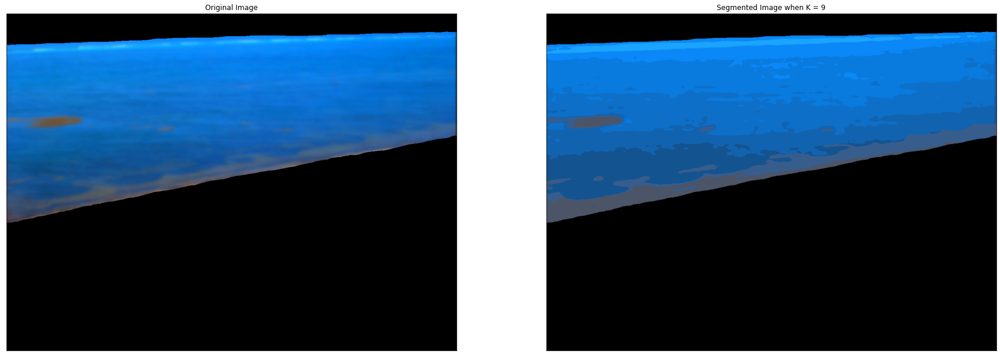

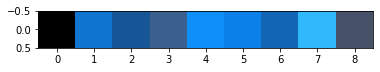

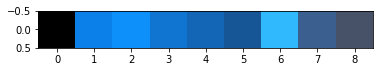

[[  0   0   0]
 [ 11 128 233]
 [ 14 144 251]
 [ 16 116 209]
 [ 19 102 182]
 [ 23  86 150]
 [ 48 185 252]
 [ 59  96 144]
 [ 71  82 105]]


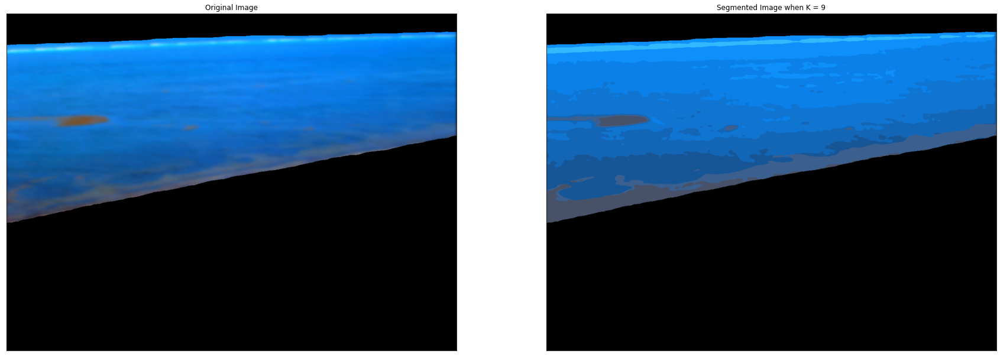

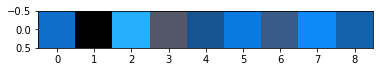

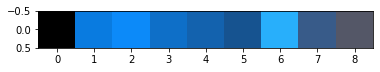

[[  0   0   0]
 [  9 123 224]
 [ 12 138 249]
 [ 14 111 200]
 [ 19  98 174]
 [ 22  83 144]
 [ 40 175 251]
 [ 56  91 137]
 [ 84  87 103]]


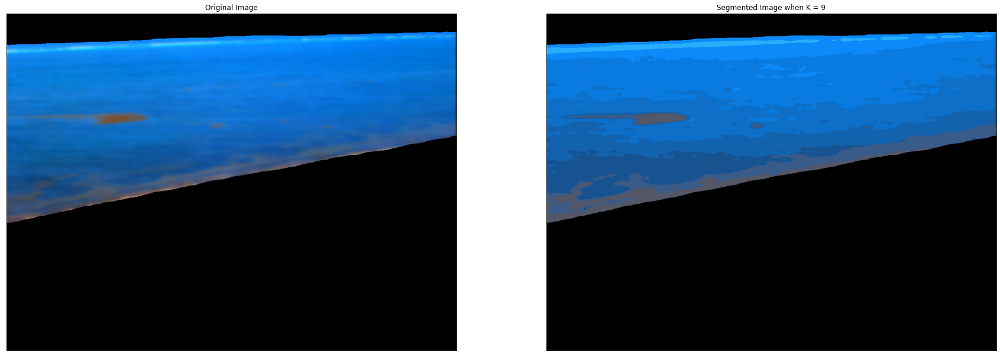

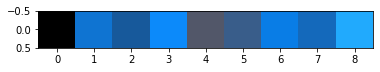

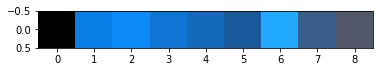

[[  0   0   0]
 [  9 125 230]
 [ 12 138 250]
 [ 15 116 210]
 [ 20 105 187]
 [ 23  89 155]
 [ 33 170 253]
 [ 57  93 138]
 [ 82  87 105]]


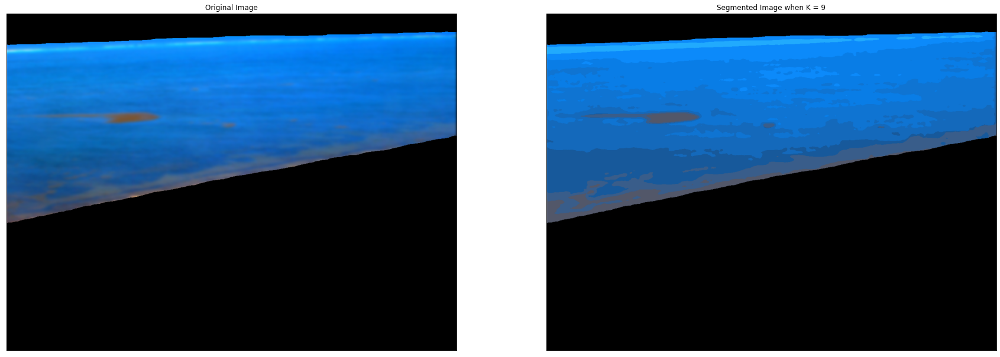

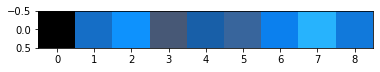

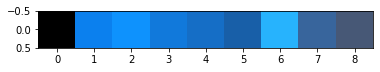

[[  0   0   0]
 [ 11 128 238]
 [ 14 146 253]
 [ 17 121 219]
 [ 21 110 198]
 [ 24  95 168]
 [ 39 179 253]
 [ 56 101 156]
 [ 71  88 118]]


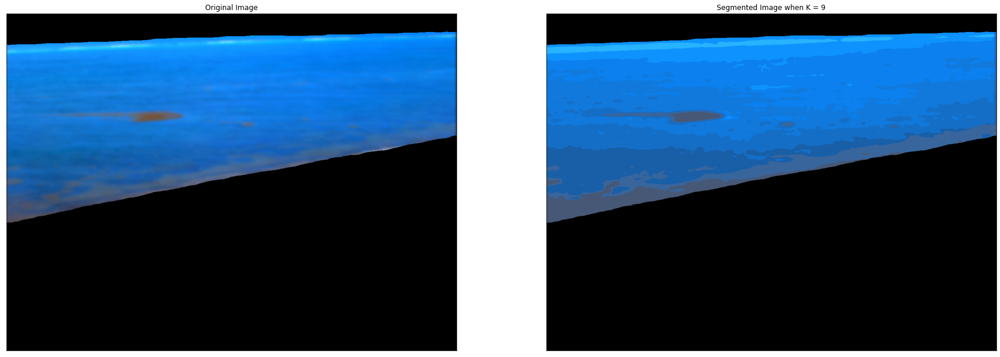

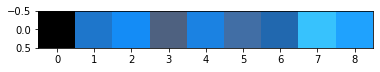

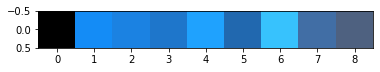

[[  0   0   0]
 [ 20 140 246]
 [ 27 130 226]
 [ 30 118 203]
 [ 31 162 254]
 [ 33 104 175]
 [ 55 194 253]
 [ 65 110 165]
 [ 78  97 128]]


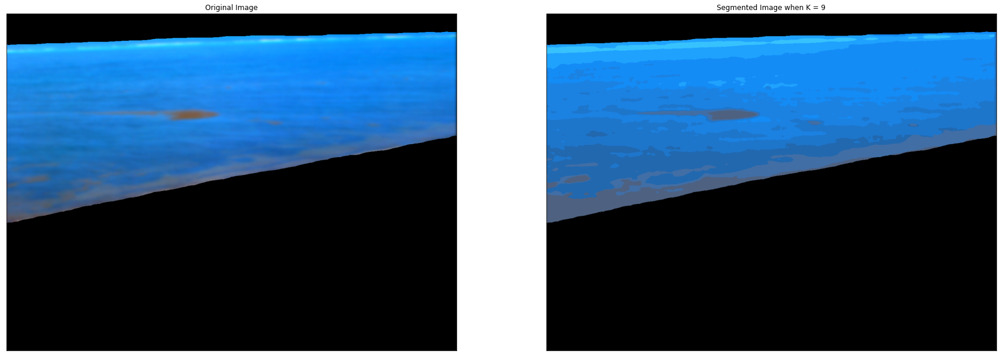

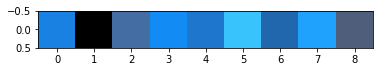

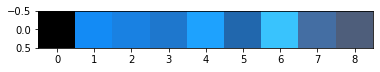

[[  0   0   0]
 [ 19 139 245]
 [ 25 129 226]
 [ 30 119 205]
 [ 30 162 254]
 [ 33 103 173]
 [ 57 195 253]
 [ 68 110 163]
 [ 78  94 123]]


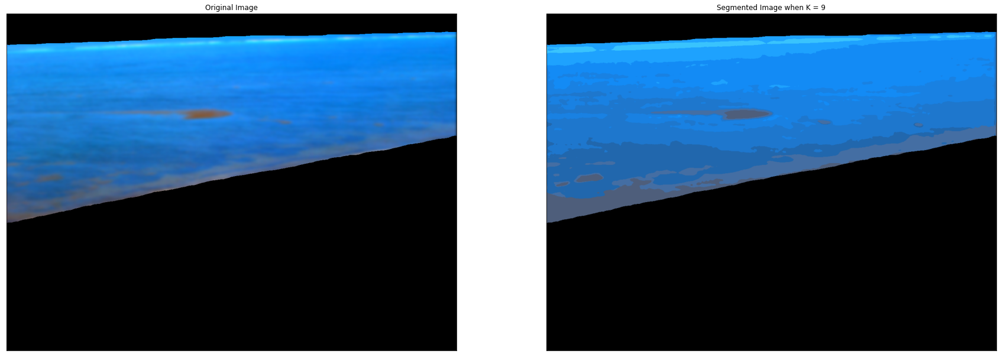

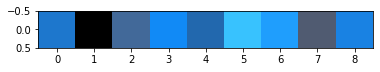

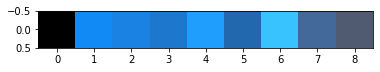

[[  0   0   0]
 [ 17 138 246]
 [ 25 130 227]
 [ 29 119 205]
 [ 31 158 253]
 [ 34 104 174]
 [ 56 194 254]
 [ 66 105 153]
 [ 80  91 113]]


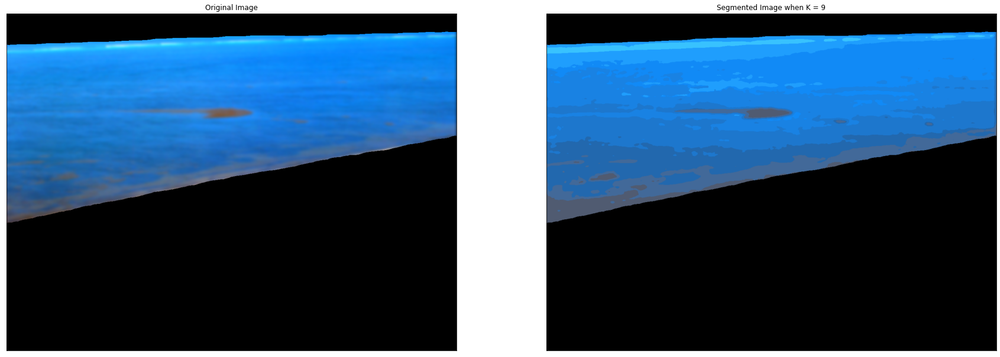

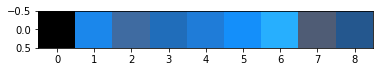

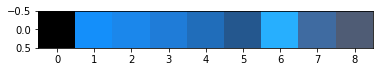

[[  0   0   0]
 [ 20 143 250]
 [ 27 135 235]
 [ 31 124 216]
 [ 32 109 186]
 [ 36  87 142]
 [ 39 175 254]
 [ 63 107 161]
 [ 79  92 117]]


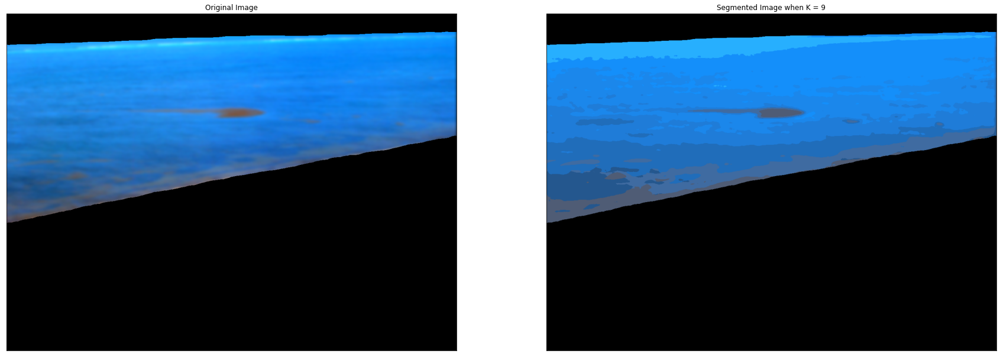

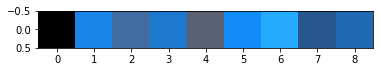

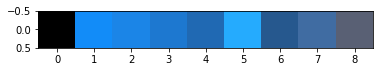

[[  0   0   0]
 [ 18 140 248]
 [ 27 133 231]
 [ 29 120 208]
 [ 32 105 179]
 [ 37 171 254]
 [ 38  88 142]
 [ 64 108 162]
 [ 89  96 116]]


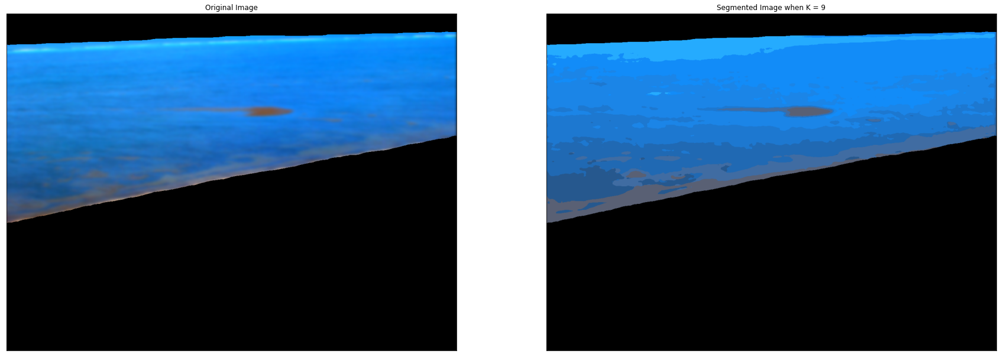

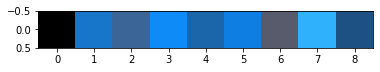

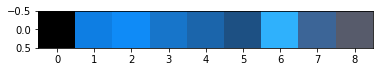

[[  0   0   0]
 [ 14 126 227]
 [ 15 139 247]
 [ 23 117 202]
 [ 27 101 171]
 [ 29  80 131]
 [ 47 177 252]
 [ 60 101 151]
 [ 87  91 107]]


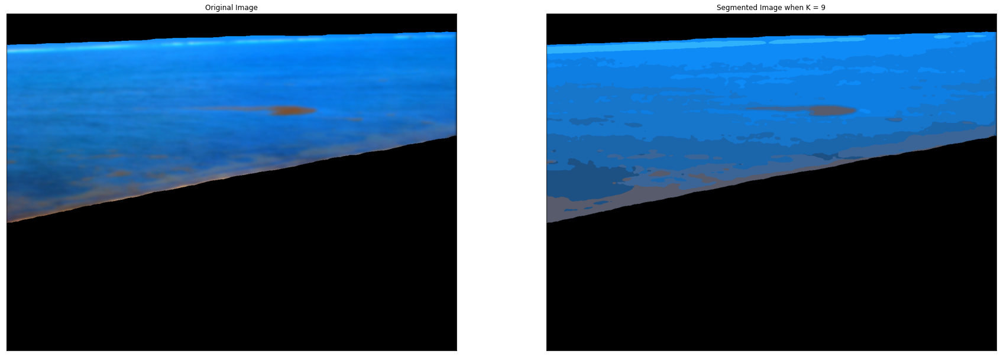

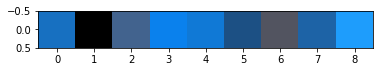

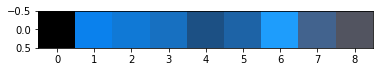

[[  0   0   0]
 [ 10 129 237]
 [ 16 121 214]
 [ 23 112 193]
 [ 28  80 132]
 [ 29  99 166]
 [ 30 157 252]
 [ 66  99 142]
 [ 82  84  96]]


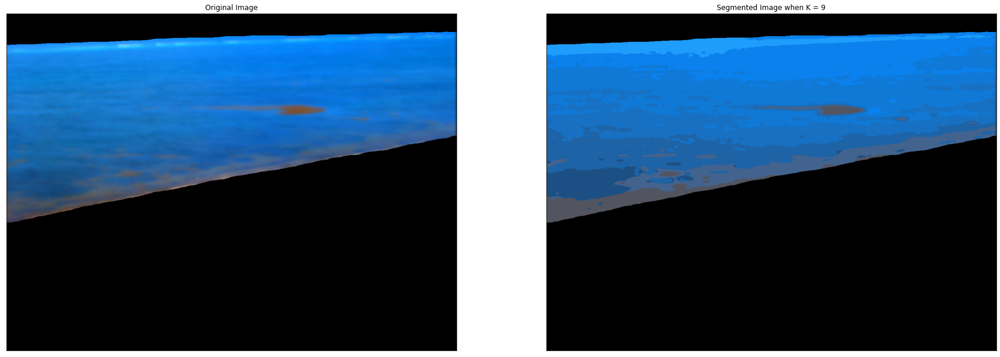

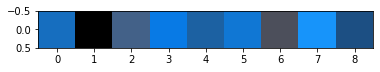

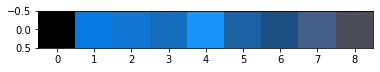

[[  0   0   0]
 [  8 122 229]
 [ 16 119 212]
 [ 22 110 191]
 [ 23 148 250]
 [ 28  97 162]
 [ 28  79 131]
 [ 67  97 136]
 [ 76  79  91]]


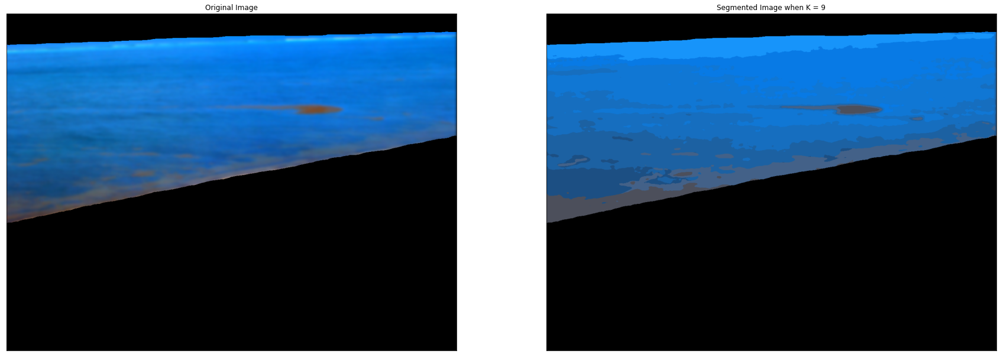

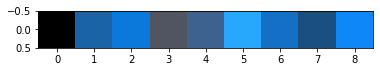

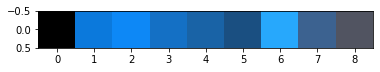

[[  0   0   0]
 [ 11 121 220]
 [ 13 136 246]
 [ 20 112 197]
 [ 25  99 166]
 [ 26  79 129]
 [ 39 168 252]
 [ 60  98 144]
 [ 81  84  97]]


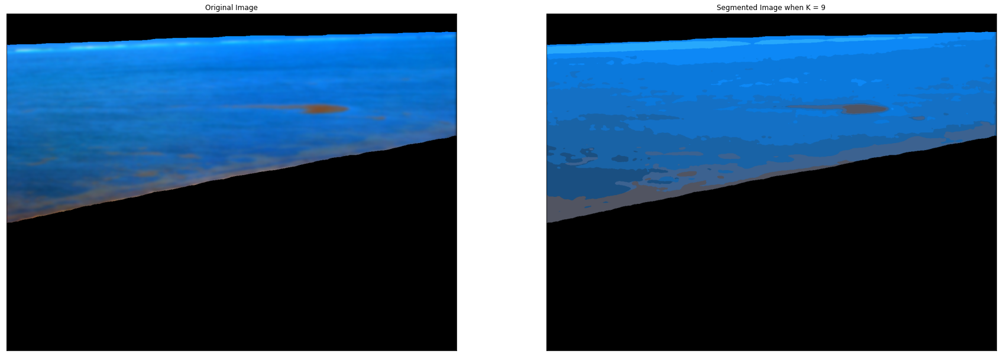

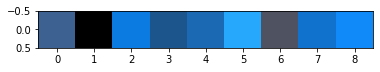

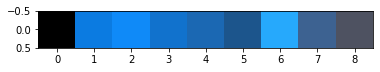

[[  0   0   0]
 [ 11 123 225]
 [ 15 138 248]
 [ 17 114 205]
 [ 27 104 179]
 [ 28  85 140]
 [ 38 169 252]
 [ 61  98 145]
 [ 78  82  97]]


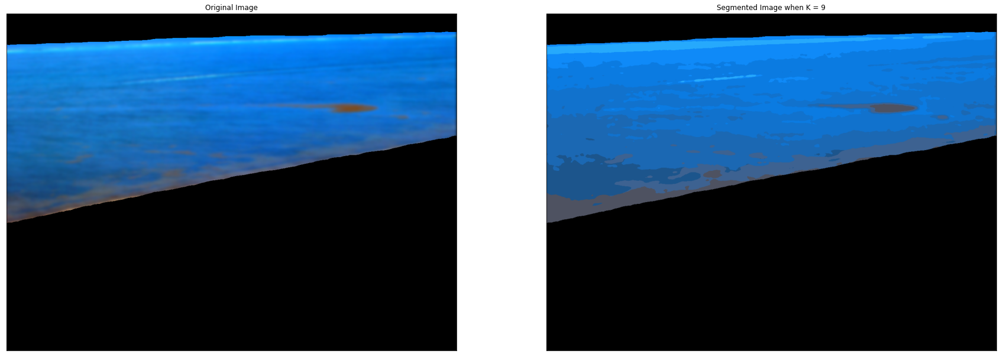

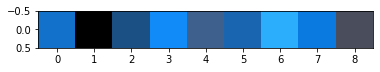

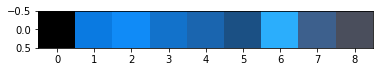

[[  0   0   0]
 [ 10 122 225]
 [ 16 139 247]
 [ 18 114 203]
 [ 26 101 175]
 [ 27  80 132]
 [ 43 174 252]
 [ 61  96 141]
 [ 74  78  92]]


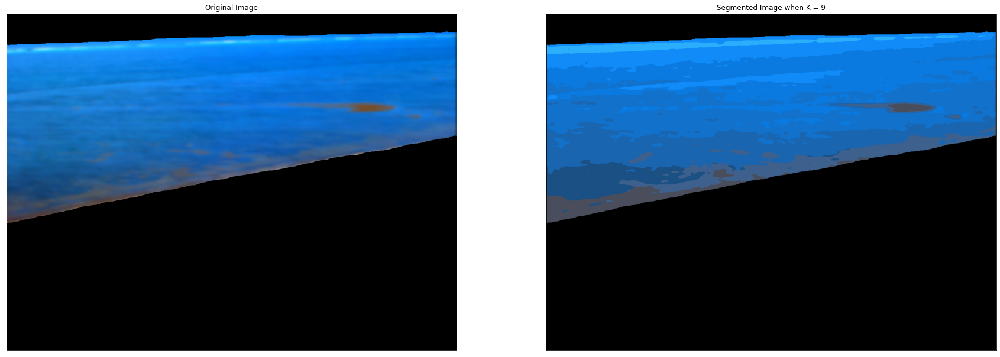

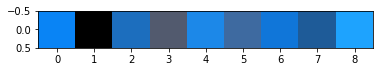

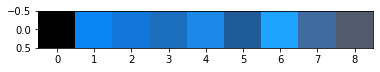

[[  0   0   0]
 [  9 132 245]
 [ 16 118 217]
 [ 28 110 190]
 [ 28 136 232]
 [ 30  91 152]
 [ 30 163 254]
 [ 62 106 160]
 [ 82  90 110]]


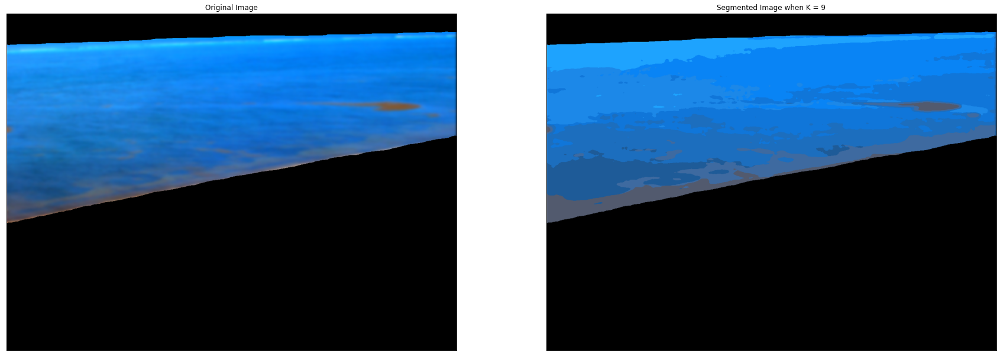

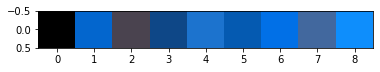

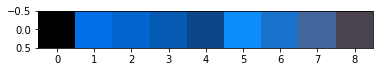

[[  0   0   0]
 [  1 112 231]
 [  3 102 206]
 [  5  90 177]
 [ 14  71 135]
 [ 14 142 252]
 [ 28 115 206]
 [ 66 104 158]
 [ 74  67  79]]


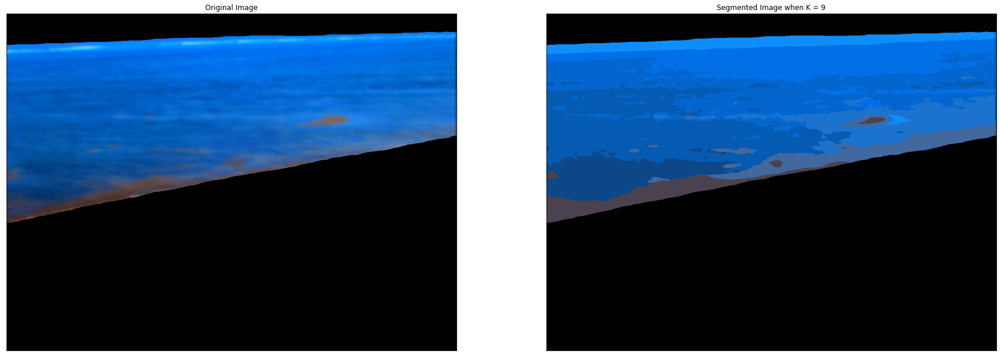

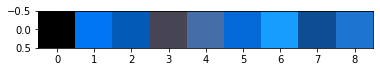

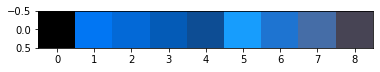

[[  0   0   0]
 [  1 118 243]
 [  3 105 215]
 [  4  91 183]
 [ 13  77 148]
 [ 23 157 253]
 [ 30 116 209]
 [ 69 109 167]
 [ 71  68  84]]


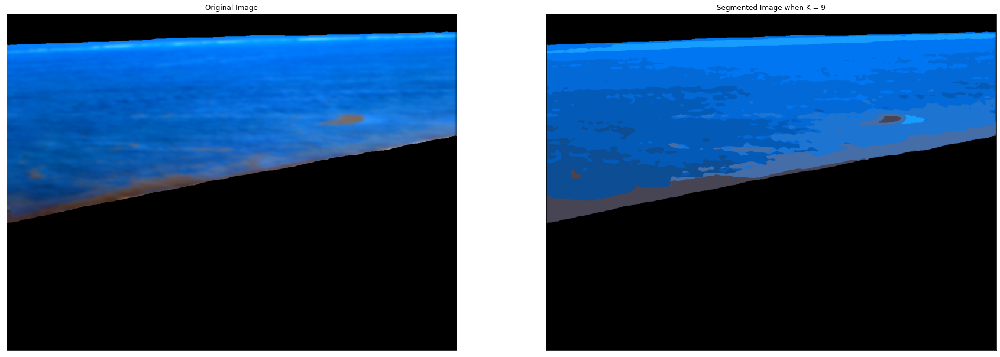

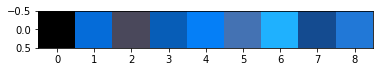

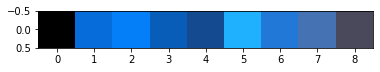

[[  0   0   0]
 [  5 108 217]
 [  5 127 247]
 [  7  93 183]
 [ 20  75 144]
 [ 31 177 254]
 [ 33 120 215]
 [ 68 114 179]
 [ 74  72  91]]


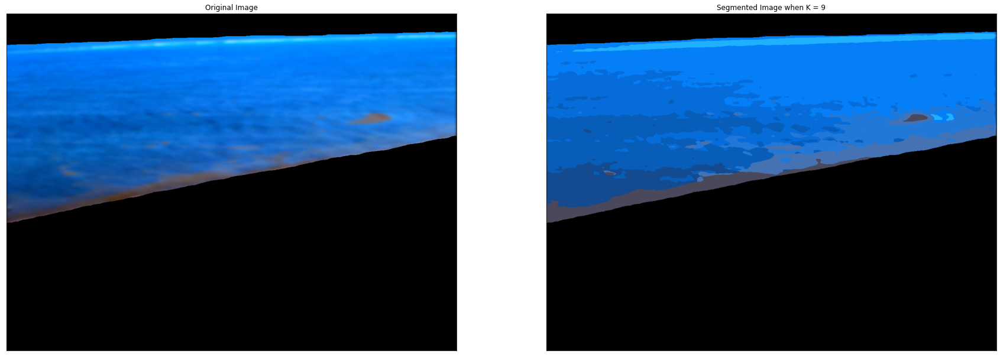

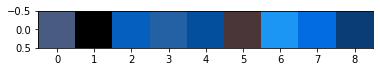

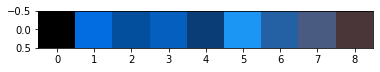

[[  0   0   0]
 [  2 109 225]
 [  3  79 158]
 [  4  95 190]
 [ 10  61 117]
 [ 28 150 244]
 [ 36  96 164]
 [ 73  91 128]
 [ 74  54  57]]


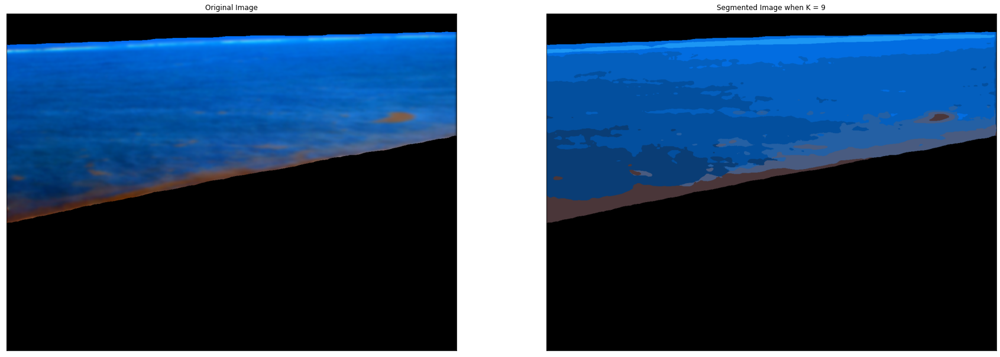

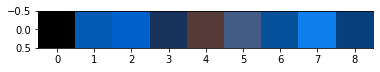

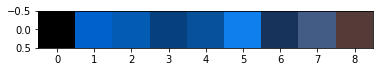

[[  0   0   0]
 [  0  97 204]
 [  4  91 180]
 [  6  64 125]
 [  7  80 154]
 [ 15 127 237]
 [ 23  51  91]
 [ 66  92 133]
 [ 85  59  55]]


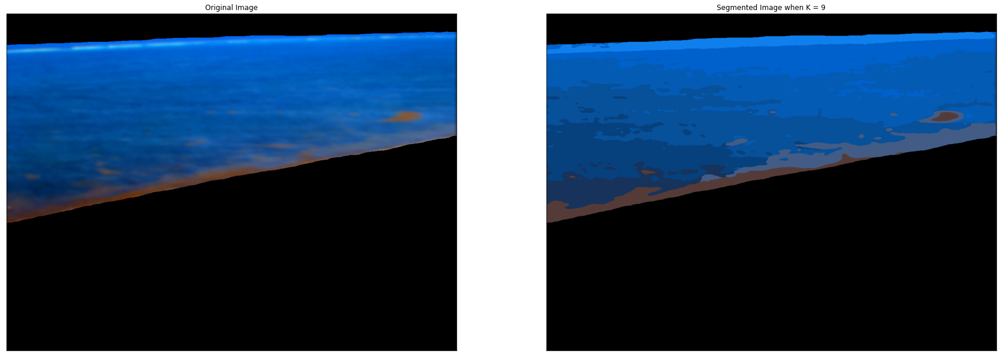

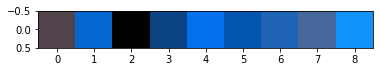

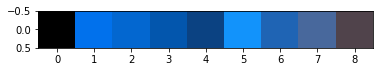

[[  0   0   0]
 [  1 113 236]
 [  3 103 208]
 [  3  86 173]
 [ 11  66 130]
 [ 18 147 251]
 [ 31 100 180]
 [ 72 104 156]
 [ 80  67  75]]


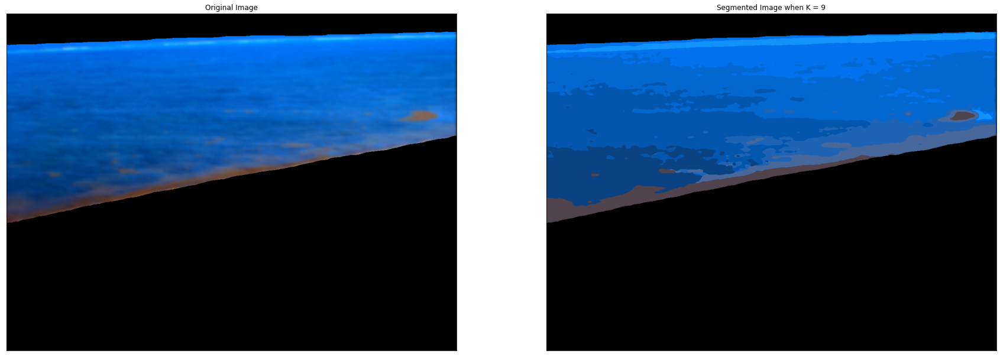

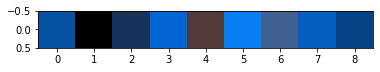

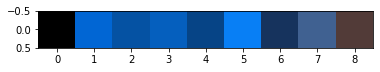

[[  0   0   0]
 [  1 102 212]
 [  5  82 163]
 [  5  95 190]
 [  6  68 134]
 [  8 127 245]
 [ 22  51  93]
 [ 64  97 145]
 [ 82  59  56]]


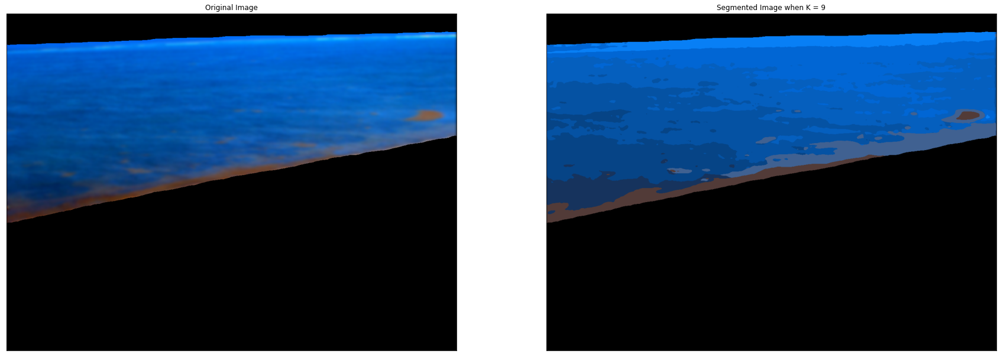

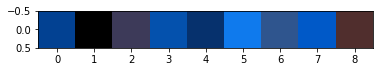

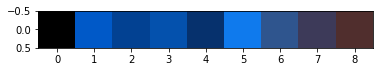

[[  0   0   0]
 [  0  89 200]
 [  2  65 146]
 [  4  81 173]
 [  6  49 109]
 [ 15 122 237]
 [ 47  85 142]
 [ 61  58  89]
 [ 80  46  45]]


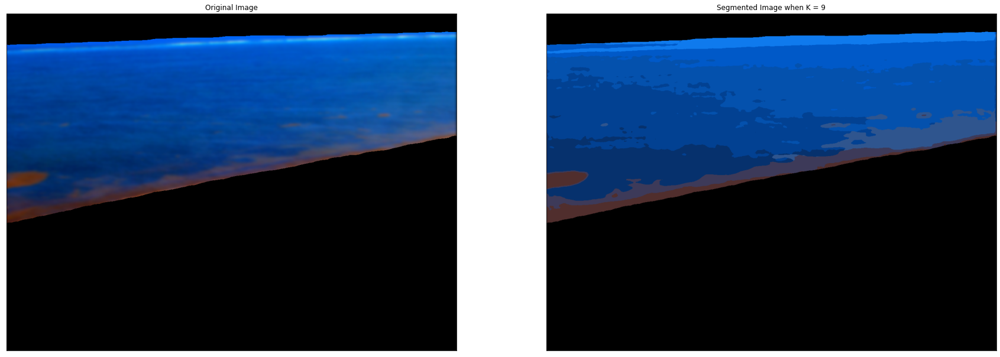

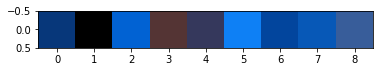

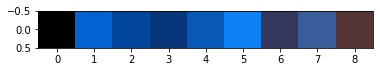

[[  0   0   0]
 [  1  98 211]
 [  2  69 157]
 [  7  55 122]
 [  7  88 183]
 [ 14 128 245]
 [ 53  56  92]
 [ 56  93 154]
 [ 84  52  52]]


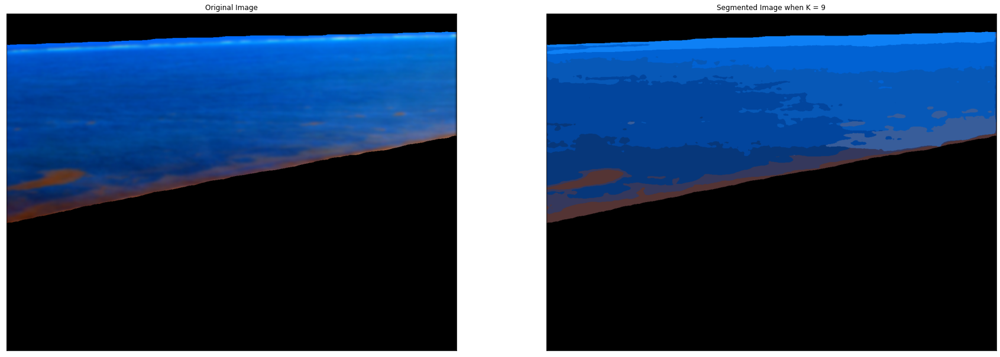

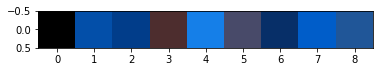

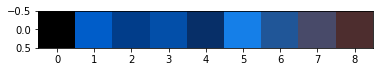

[[  0   0   0]
 [  0  93 201]
 [  1  61 138]
 [  3  79 169]
 [  7  47 104]
 [ 21 127 232]
 [ 32  86 152]
 [ 72  74 105]
 [ 77  45  46]]


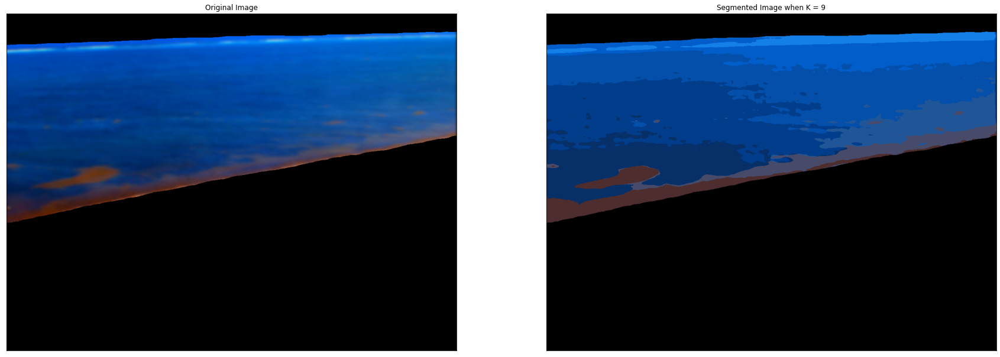

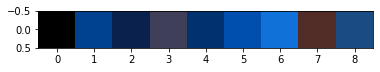

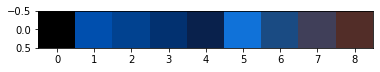

[[  0   0   0]
 [  0  79 174]
 [  1  66 144]
 [  2  49 112]
 [  9  33  76]
 [ 16 114 217]
 [ 26  75 131]
 [ 64  63  89]
 [ 82  45  40]]


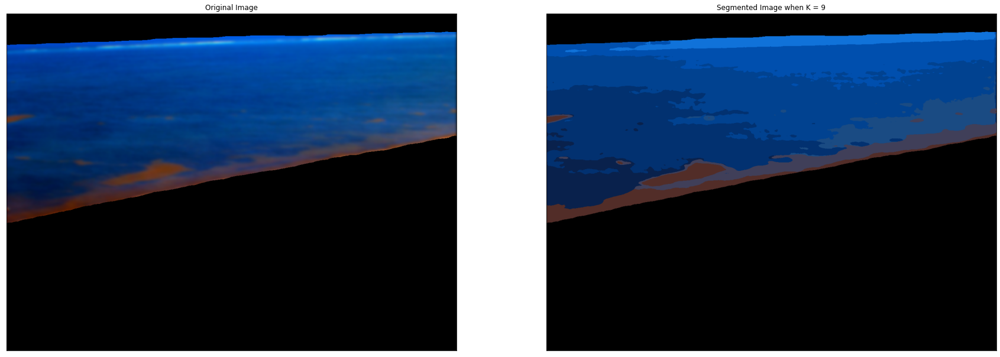

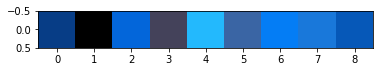

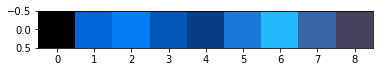

[[  0   0   0]
 [  3 102 218]
 [  4 125 245]
 [  6  88 184]
 [  7  61 134]
 [ 25 120 218]
 [ 35 185 253]
 [ 58 101 164]
 [ 68  66  90]]


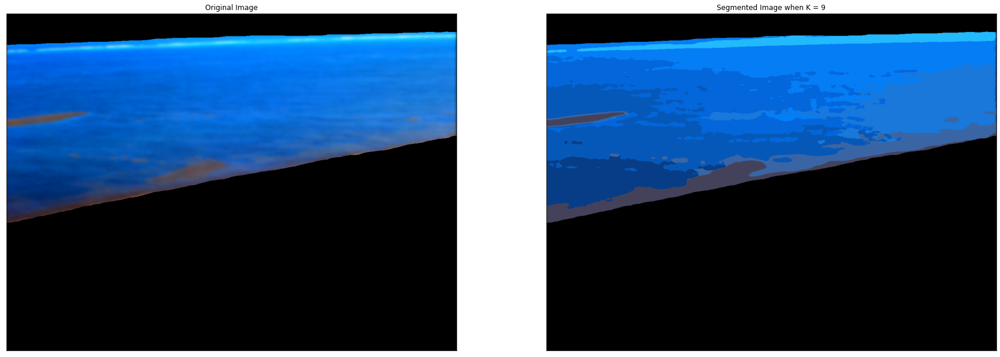

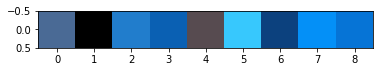

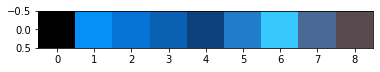

[[  0   0   0]
 [  4 144 247]
 [  6 116 214]
 [ 10  96 179]
 [ 12  65 126]
 [ 33 125 204]
 [ 55 200 253]
 [ 74 106 149]
 [ 87  75  80]]


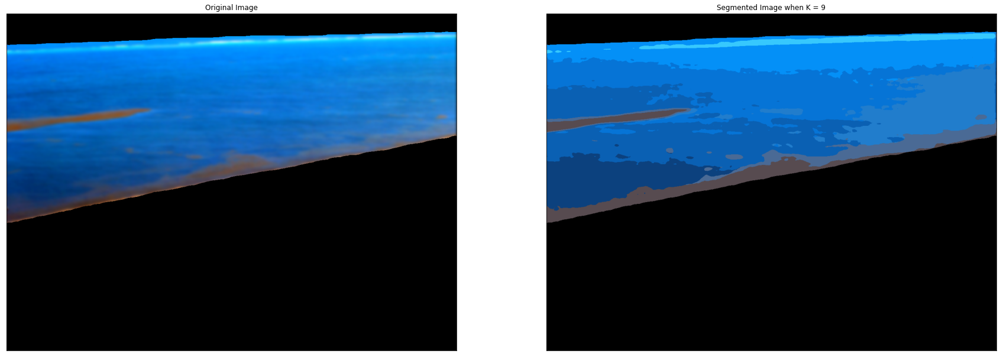

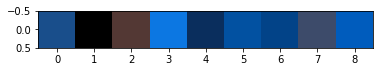

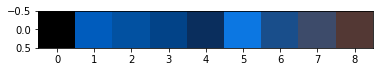

[[  0   0   0]
 [  0  92 189]
 [  2  81 161]
 [  2  67 136]
 [ 10  46  93]
 [ 12 119 226]
 [ 25  78 139]
 [ 61  75 106]
 [ 83  56  52]]


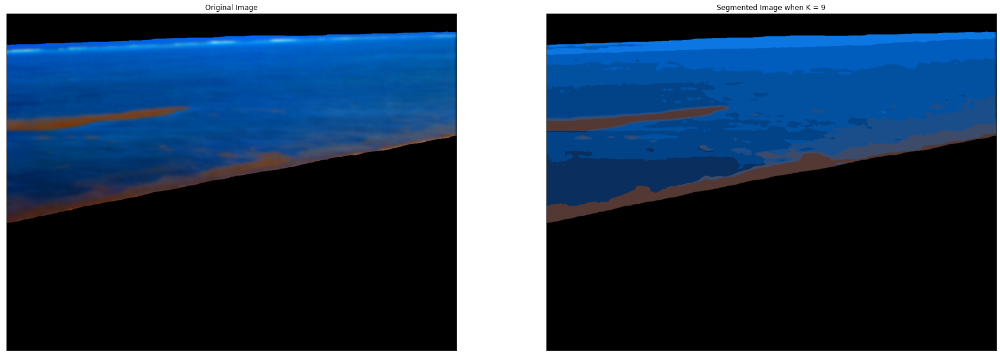

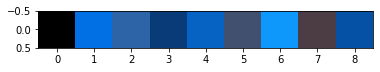

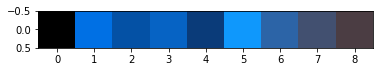

[[  0   0   0]
 [  0 112 228]
 [  4  81 165]
 [  6  99 196]
 [ 10  59 121]
 [ 15 152 252]
 [ 44 100 167]
 [ 66  80 112]
 [ 75  61  67]]


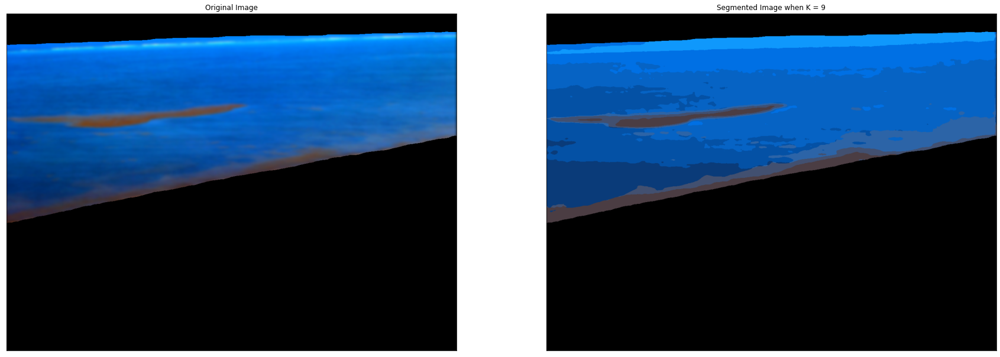

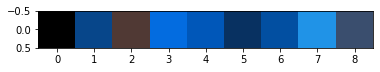

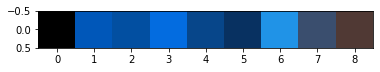

[[  0   0   0]
 [  0  87 185]
 [  2  79 161]
 [  3 108 224]
 [  7  70 138]
 [  8  49  97]
 [ 32 147 231]
 [ 58  78 110]
 [ 80  57  52]]


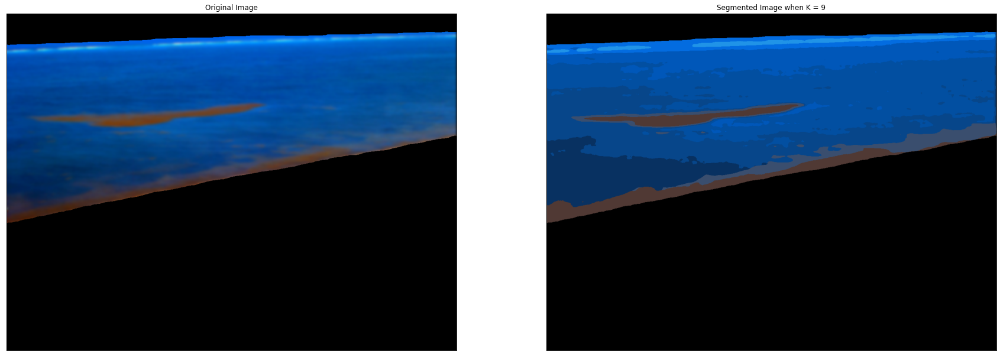

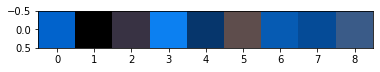

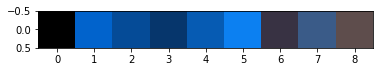

[[  0   0   0]
 [  1  99 204]
 [  5  75 151]
 [  6  54 108]
 [  6  91 179]
 [ 12 128 241]
 [ 56  50  67]
 [ 58  91 136]
 [ 94  77  76]]


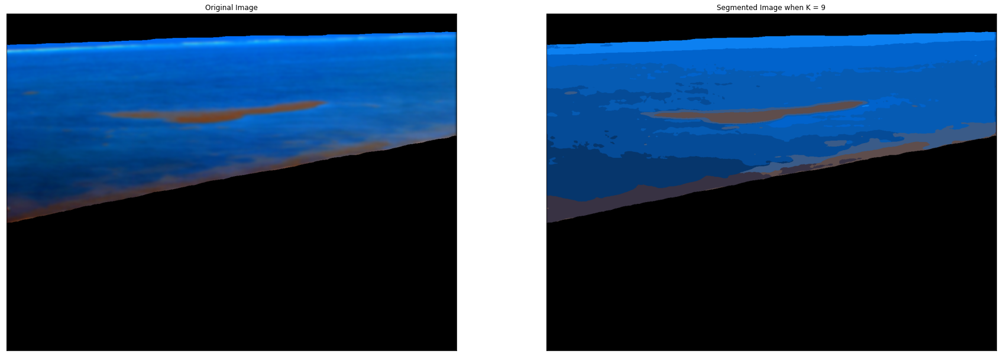

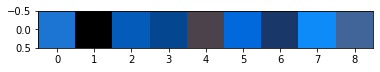

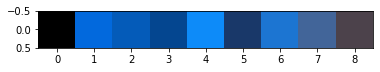

[[  0   0   0]
 [  2 105 221]
 [  4  91 185]
 [  4  70 144]
 [ 13 139 249]
 [ 25  56 105]
 [ 28 117 210]
 [ 66 101 153]
 [ 76  66  75]]


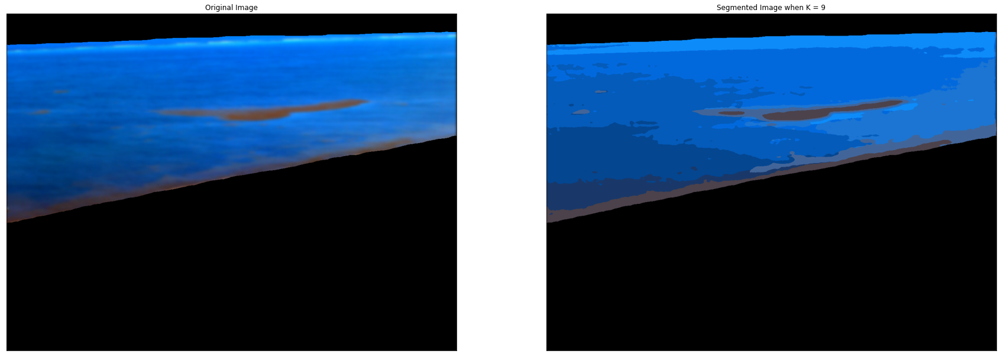

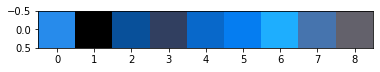

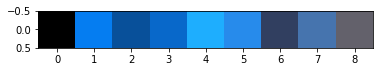

[[  0   0   0]
 [  5 125 241]
 [  8  80 154]
 [  8 104 202]
 [ 30 174 254]
 [ 39 139 235]
 [ 49  63  96]
 [ 70 116 174]
 [ 99  97 107]]


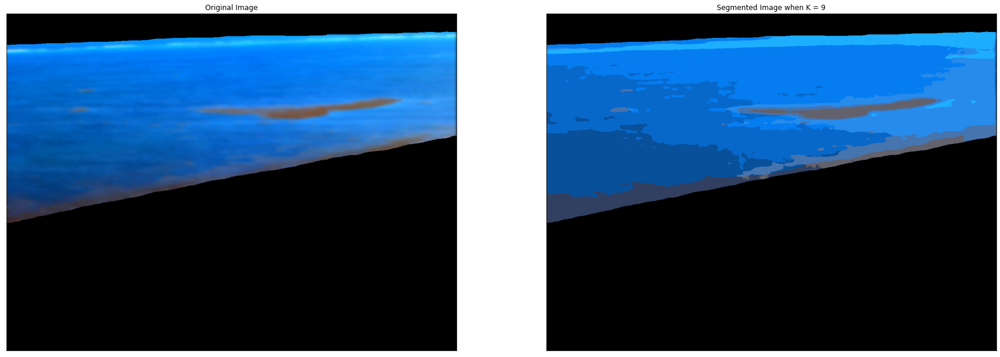

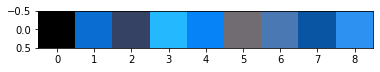

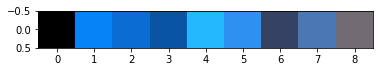

[[  0   0   0]
 [  6 132 247]
 [  9 109 210]
 [  9  85 163]
 [ 36 185 254]
 [ 44 145 240]
 [ 53  66  99]
 [ 73 120 179]
 [113 108 113]]


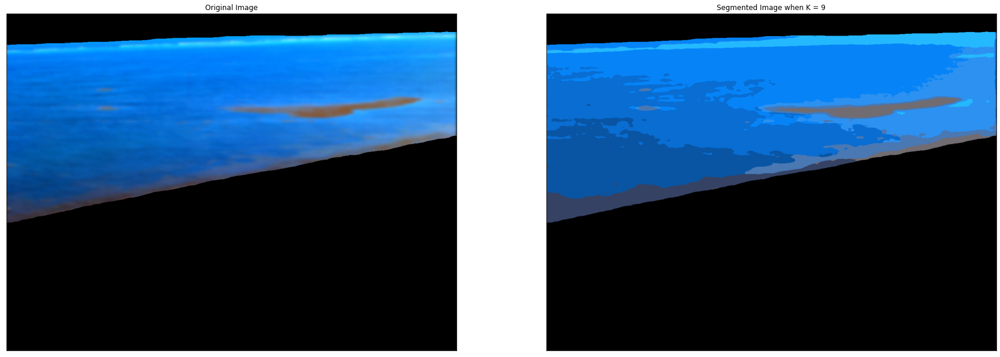

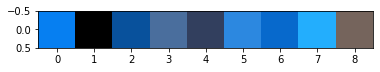

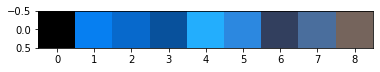

[[  0   0   0]
 [  6 127 241]
 [  7 105 204]
 [  8  81 156]
 [ 35 174 253]
 [ 44 136 224]
 [ 50  63  94]
 [ 74 110 157]
 [117 100  92]]


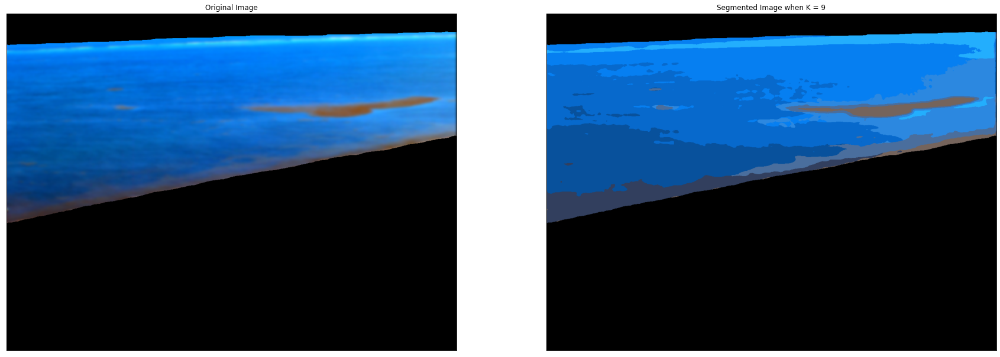

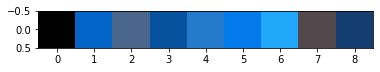

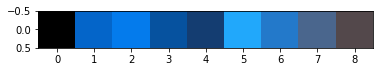

[[  0   0   0]
 [  4 101 201]
 [  4 123 236]
 [  6  82 159]
 [ 20  61 113]
 [ 33 168 251]
 [ 35 121 202]
 [ 74 102 141]
 [ 83  72  75]]


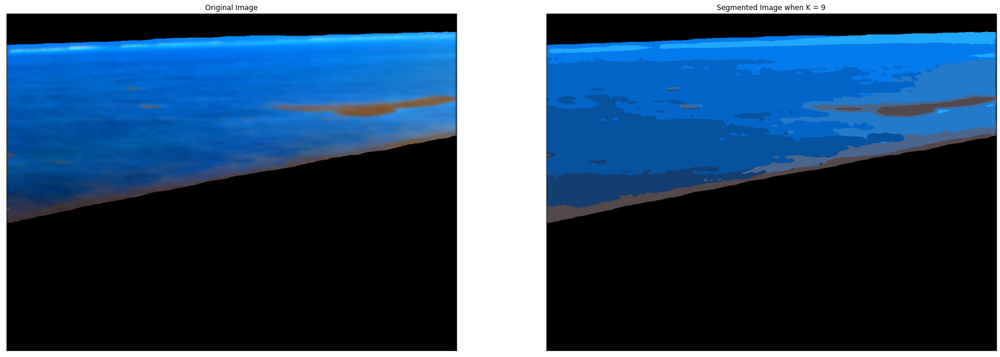

In [ ]:
train_images_kmeans, train_images_kmeans_rgb = getKmeans(train_images_firstmask, 9, 10) # K and attempts values were obtained by trial-and-error

In [ ]:
# Obtention of k-means generated centroid colours that represent sargasso; colours with R value higher than 40 and B value lower than 200 (observed pattern from above results)

sargasso_colors = []

for colorlist in train_images_kmeans_rgb:
  image_colours = []
  for i in range(len(colorlist)):
    if colorlist[i][0] > 40 and colorlist[i][2] < 200:
      image_colours.append(colorlist[i])
  sargasso_colors.append(image_colours)

###Sargasso and ocean masks obtention from k-means colours

In [ ]:
# Function to obtain masks from k-means results
# Receives the images to mask, the initial mask to define the indexes for pixels to be processed (in this case, pixels that aren't beach or sky) and if its sargasso or ocean

def maskFromKmeans(image_list, general_mask, mask_type, sargasso_rgb = None):
  mask_list = []
  img_idx = 0
  eval_zone = np.nonzero(general_mask)

  for image in image_list:
    res_mask = np.zeros_like(general_mask)
    # Pixels corresponding to ocean and sargasso
    eval_pixels = image[eval_zone[0], eval_zone[1]]
    pxl_idx = 0
    for pixel in eval_pixels:
      if mask_type == 0: # Zero for sargasso
        # If the pixel values are in the corresponding list of colours for sargasso, then set as 255, rest stays as 0
        if any((pixel == x).all() for x in sargasso_rgb[img_idx]):
          res_mask[eval_zone[0][pxl_idx]][eval_zone[1][pxl_idx]] = 255
      elif mask_type == 1: # One for ocean
        # If the pixel is 0 (ocean in the sargasso mask, since the function receives the sargasso masks obtained previously), set to 255
        if pixel == 0:
          res_mask[eval_zone[0][pxl_idx]][eval_zone[1][pxl_idx]] = 255
      pxl_idx += 1
    # Adds generated sargasso mask to list of sargasso images
    mask_list.append(res_mask)
    img_idx += 1

  return mask_list

In [ ]:
train_images_masks_sargasso = maskFromKmeans(train_images_kmeans, initial_mask, 0, sargasso_colors)
print("Obtained sargasso masks.")

Obtained sargasso masks.


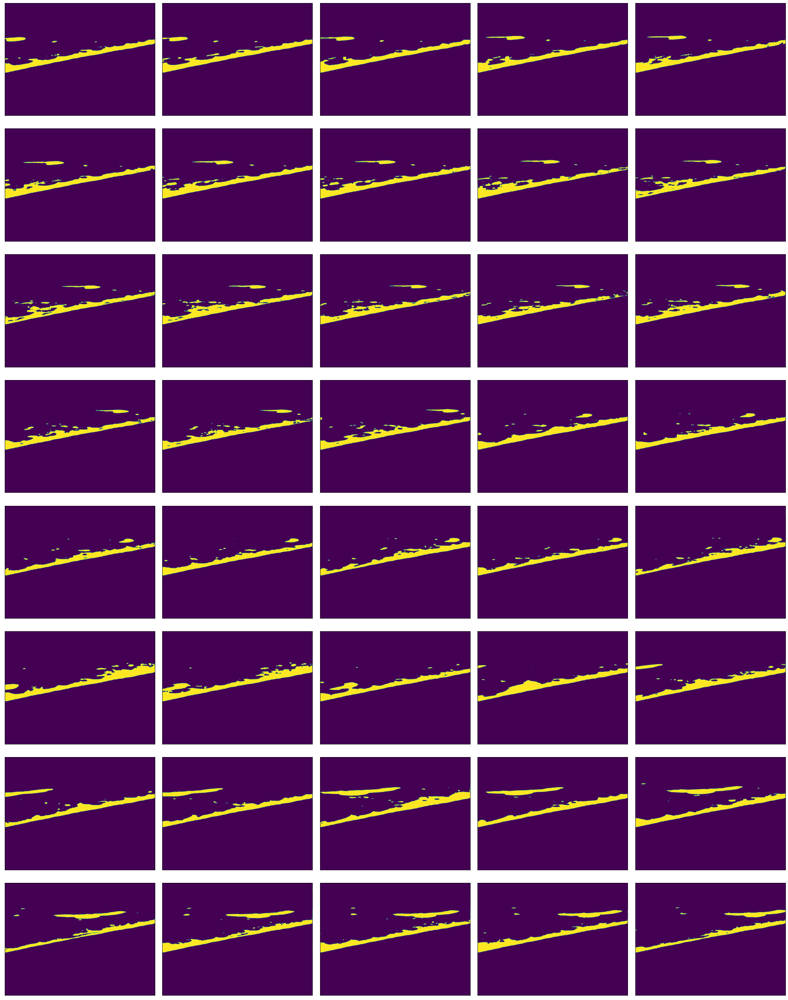

In [ ]:
plot_images(train_images_masks_sargasso, 5, 8, range(0, 40))

In [ ]:
train_images_masks_ocean = maskFromKmeans(train_images_masks_sargasso, initial_mask, 1)
print("Obtained ocean masks.")

Obtained ocean masks.


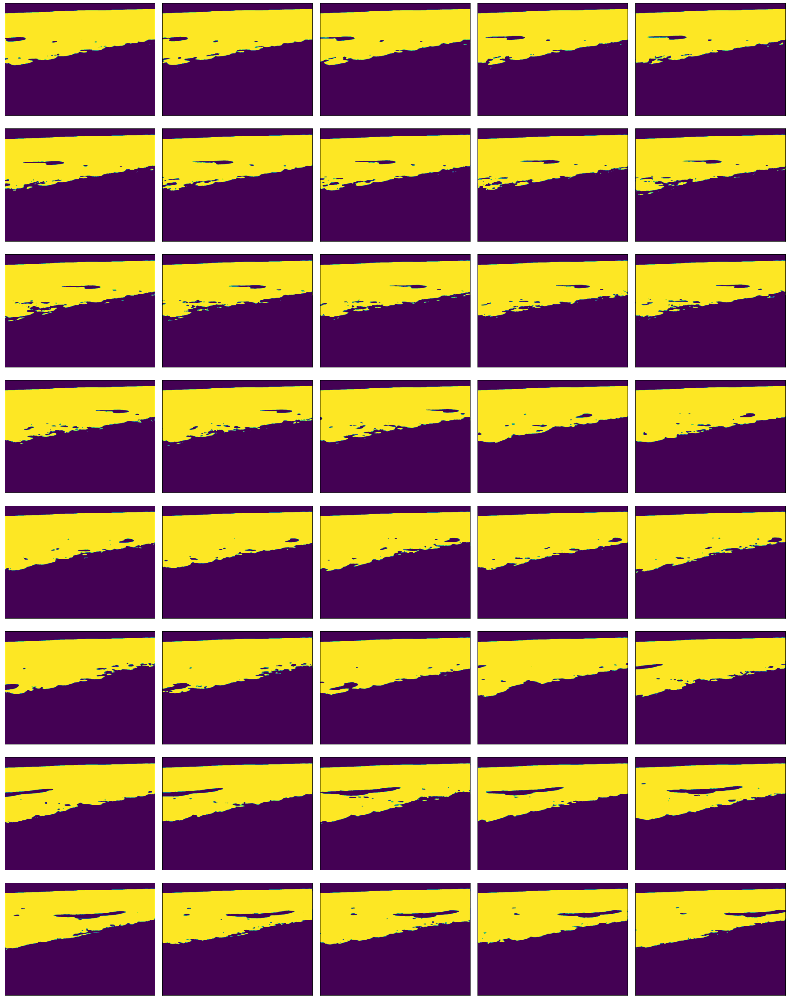

In [ ]:
plot_images(train_images_masks_ocean, 5, 8, range(0, 40))

# 4. Feature vector

Se obtiene el vector de características. Se utilizan las coordenadas de los píxeles así como sus valores RGB. Se obtienen las coordenadas a partir de los valores que no son cero de la máscara (en este caso, son todos 255). A partir de esta información, se obtienen los valores RGB de los píxeles diferentes de cero. Finalmente, se concatenan las coordenadas y los valores RGB obtenidos, dando como resultado un arreglo de arreglos, siendo que cada arreglo son las características de un píxel.

In [ ]:
# Function to obtain feature vector, formed by each pixel's coordinates and RGB values

def featVector(images, masks):

  featVector = np.array([])
  tempComp = np.array([])
  seed(0)

  for i in range (0, len(images)):
    image = images[i].copy()
    if type(masks) is list: # If we get a list of masks, for sargasso or ocean
      mask = np.asarray(np.nonzero(masks[i])) # We get an array of indices of non-zero values, which we'll use to get appropiate pixels to get color from
    else: # If we get the initial mask, for the background (beach and sky)
      mask = np.asarray(np.nonzero(masks == 0))
    colours = image[mask[0], mask[1], :] # We get all colour values for the indicated range; mask[0] indicates column, mask[1] indicates row
    #featArray = colours # One row per pixel, 3 features per row (r, g, b)
    featArray = np.concatenate((mask.transpose(), colours), axis = 1)  # One row per pixel, 5 characteristics per row (column, row, r, g, b)
    if i == 0:
      featVector = featArray
    else:
      featVector = np.vstack((featVector, featArray)) # Add all rows from each image
  
  return featVector

In [ ]:
# Generate images with filters applied and initial mask applied, but substituting the discarded pixels with an array with random integers between 0 to 5 (RGB values close to 0)
# instead of all 0s to avoid singular matrixes when calculating the statistics
train_images_for_featvector = maskSustitution(train_images_filtered, initial_mask, random = True)

train_sargasso = featVector(train_images_for_featvector, train_images_masks_sargasso)
train_ocean = featVector(train_images_for_featvector, train_images_masks_ocean)
train_background = featVector(train_images_for_featvector, initial_mask)

In [ ]:
n_samples = train_sargasso.shape[0] + train_ocean.shape[0] + train_background.shape[0] # Shape is number of rows (events) and number of features

print(n_samples) # Total of events
print(train_sargasso.shape[1]) # Total features

49152000
5


In [ ]:
train_sargasso

array([[293, 121,  48, 109, 168],
       [293, 122,  48, 109, 168],
       [293, 123,  48, 109, 168],
       ...,
       [596,   1,  82,  55,  61],
       [596,   2,  80,  56,  62],
       [596,   3,  78,  57,  63]])

In [ ]:
train_ocean

array([[  53, 1248,    2,  137,  255],
       [  53, 1249,    2,  137,  255],
       [  53, 1250,    2,  137,  255],
       ...,
       [ 554,   87,   44,   50,   76],
       [ 562,   17,   47,   52,   82],
       [ 563,   17,   47,   52,   83]])

In [ ]:
train_background

array([[   0,    0,    4,    0,    3],
       [   0,    1,    4,    0,    3],
       [   0,    2,    4,    0,    3],
       ...,
       [ 959, 1277,    4,    2,    3],
       [ 959, 1278,    4,    2,    3],
       [ 959, 1279,    4,    2,    3]])

# 5. Covariance matrix and statistics

Se obtiene la matriz de covarianza y los estadísticos muestrales. En este caso, la media de cada característica, la matriz de covarianza, el determinante de la matriz y su inversa, y la probabilidad a priori de cada clase.

In [ ]:
# Function to obtain the statistics of the feature vectors of each train set (one set per class)

def statistics(trainData, n_samples):

  mean = trainData.mean(axis = 0) # Mean of each feature
  sigma = np.cov(trainData.T) # Covariance matrix
  sigma_det = np.linalg.det(sigma) # Determinant of covariance matrix, to use on Bayes rule
  sigma_inv = np.linalg.inv(sigma) # Inverse of covariance matrix, to use on Bayes rule
  priori = trainData.shape[0] / n_samples # A priori probability, obtained dividing number of samples of a class by total number of samples

  return(mean, sigma_det, sigma_inv, priori)

#6. Naive Bayes classifier

Se utiliza la fórmula para determinar la clase más probable a la que cada píxel de la entrada pertenece.
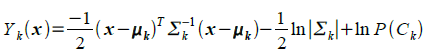

Para esto, se obtiene el vector de cada píxel de la imagen de entrada, se aplica la fórmula y, según el resultado de la clase más probable, a dicho píxel se le asignará un color específico.

In [ ]:
# Function to obtain the class with the highest probability of each pixel based on its feature vector and its relation to the statistics of each class

def obtainClass(classes, entry): # Dictionary with classes as keys and statistics as values, and data to classify

  probabilities = dict()

  for class_i, statistic in classes.items(): # For each class
    factor = 1/2 * np.log(statistic[1])
    exponential = -1/2 * np.dot((entry - statistic[0].T) @ statistic[2], entry - statistic[0])
    priori = np.log(statistic[3])
    probabilities[class_i] = exponential - factor + priori # Apply naive Bayes formula
  
  max_probability = max(probabilities, key = probabilities.get) # Get class with highest probability

  return max_probability

In [ ]:
# Dictionary with colours for each class
colours = {"Background":(110, 110, 110),"Ocean":(76, 118, 171),"Sargasso":(131, 95, 42)}

In [ ]:
# Function to obtain regions identified by colours

def regions(classes, image, colours): # Receives classes dictionary, entry image and colours dictionary

  entryImg = np.asarray(image)
  shape = entryImg.shape[:2]
  shape = shape[::-1] # Fixes shape
  blankImg = Image.new('RGB', shape) # Creates new blank image with same shape as entry image
  arrayImg = np.array(blankImg) # Converts said image to array, for ease of use

  # For each pixel:
  for i in range(blankImg.size[1]):
    for j in range(blankImg.size[0]):
      featVector = np.array([i, j, entryImg[i, j, 0], entryImg[i, j, 1], entryImg[i, j, 2]]) # Creates feature vector with XYRGB values
      #featVector = np.array([entryImg[i, j, 0], entryImg[i, j, 1], entryImg[i, j, 2]]) # Creates feature vector with RGB values
      highClass = obtainClass(classes, featVector) # Obtains class with highest probability
      arrayImg[i, j] = np.array(colours[highClass]) # Puts respective colour on final image
    
  regions = Image.fromarray(arrayImg) # Converts array back to image

  return regions

In [ ]:
# Dictionaries of classes and their respective statistics
classes = {"Background":statistics(train_background, n_samples),
           "Sargasso":statistics(train_sargasso, n_samples),
           "Ocean":statistics(train_ocean, n_samples)}

#7. Obtention of images with classified pixels

Se obtienen las imágenes con los píxeles clasificados (color café para sargazo, azul para el océano y gris para el fondo, compuesto por la playa y el cielo) a partir de imágenes diferentes a las usadas para el entrenamiento.

Antes de realizar el clasificado, a las imágenes de prueba se les aplica el mismo preprocesamiento que a las utilizadas en el entrenamiento (filtros de ajustes de color, contraste y brillo, filtro gaussiano y aplicación de la máscara inicial).

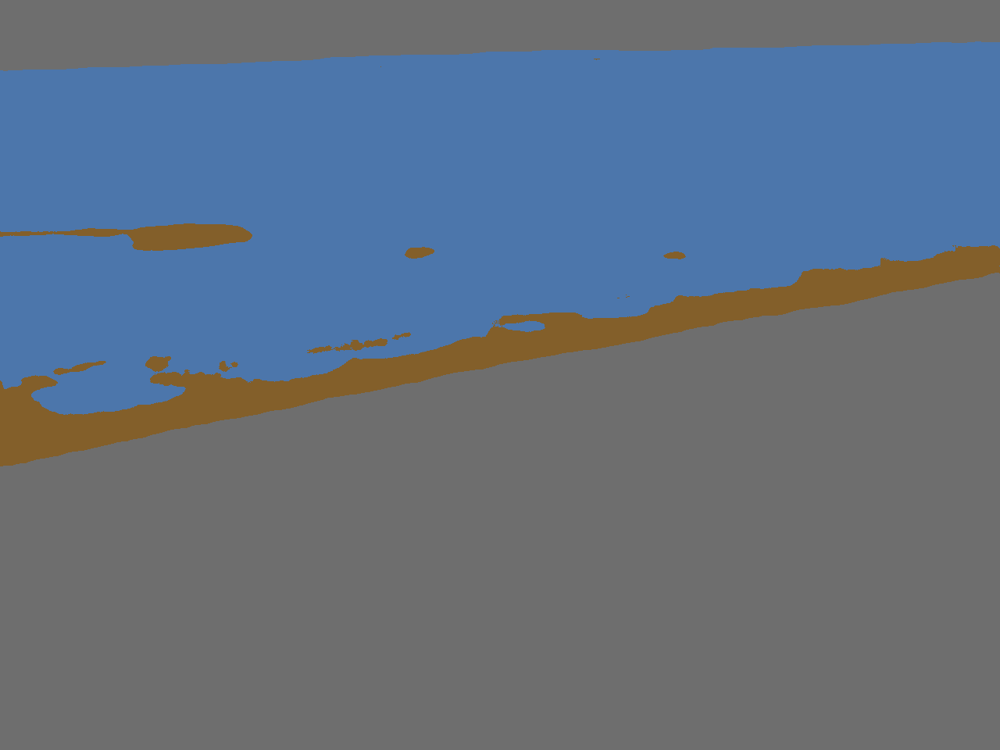

Imagen 1 procesada.



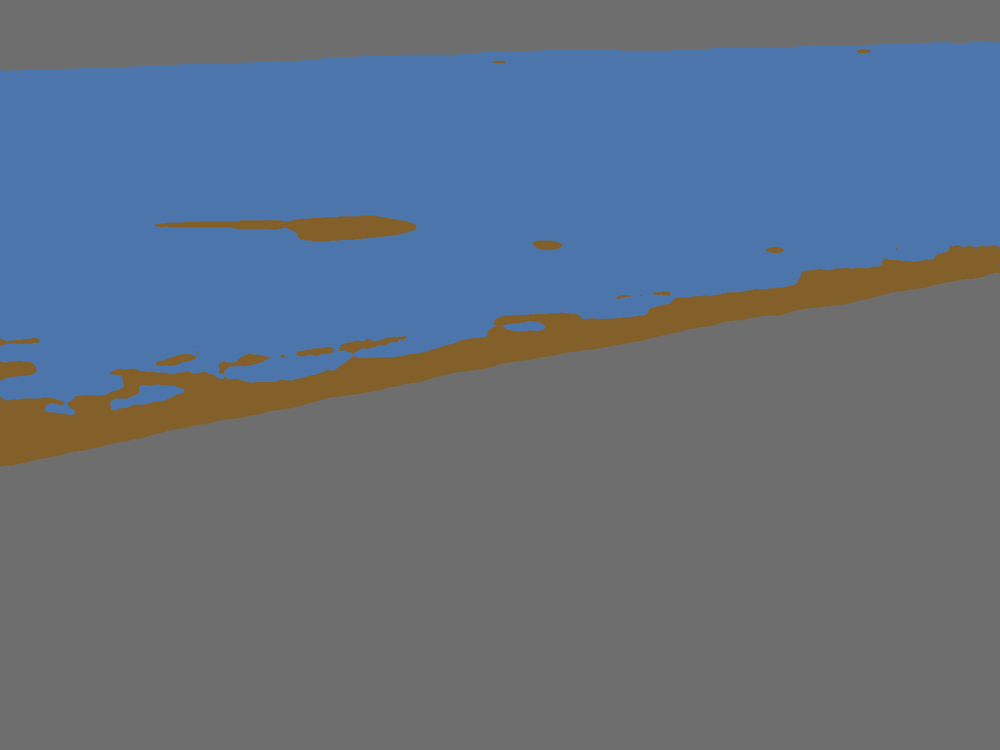

Imagen 2 procesada.



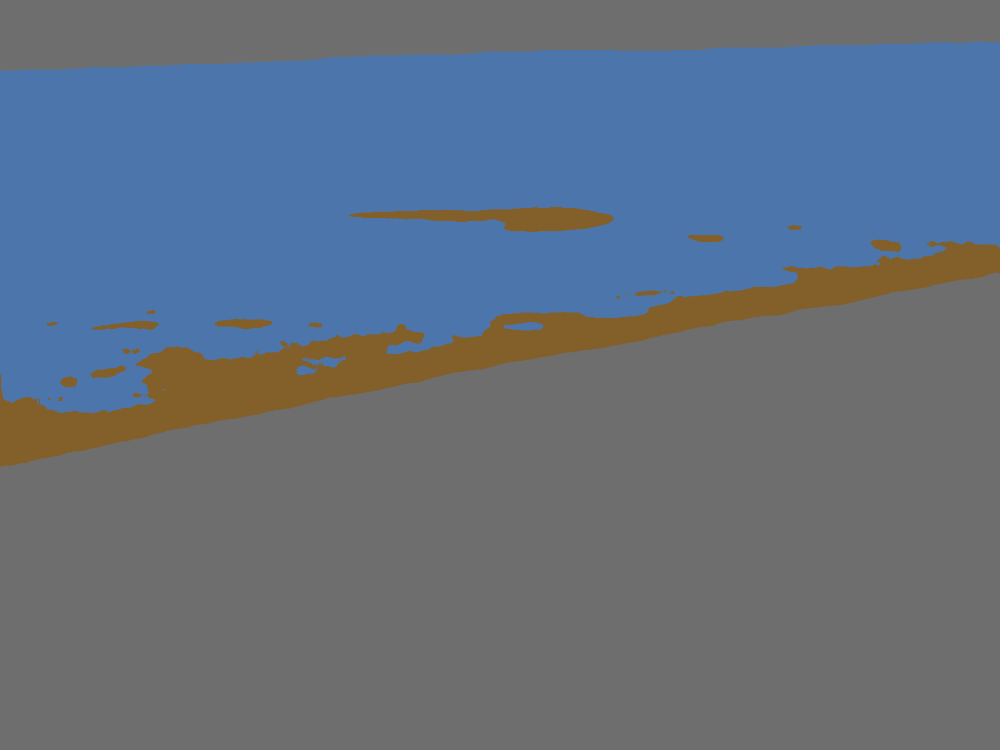

Imagen 3 procesada.



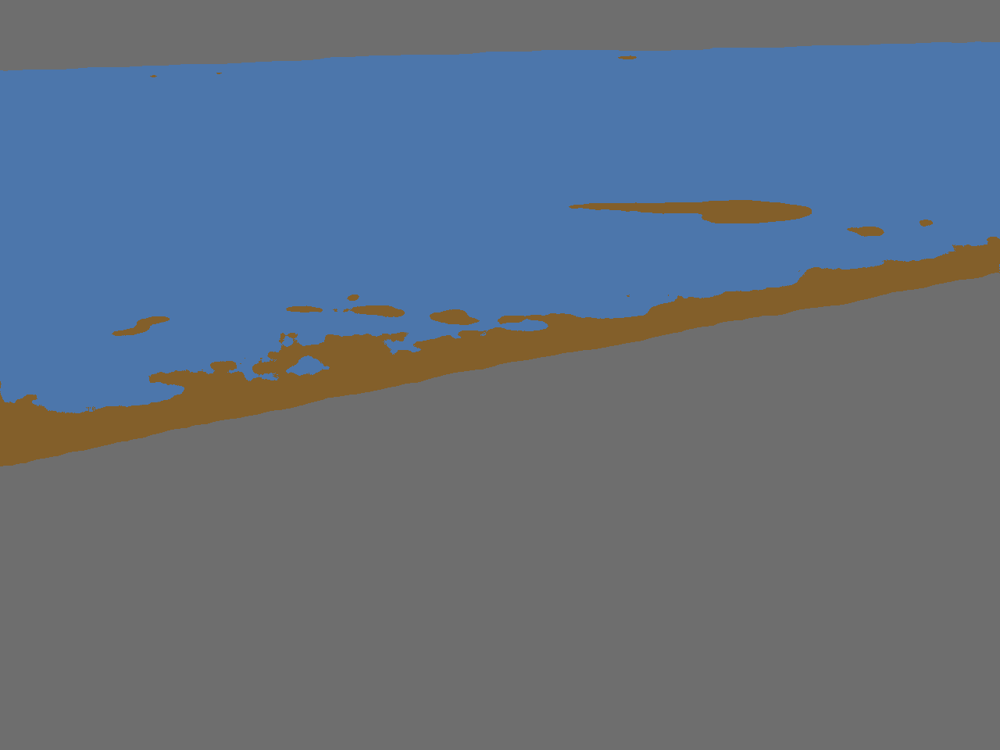

Imagen 4 procesada.



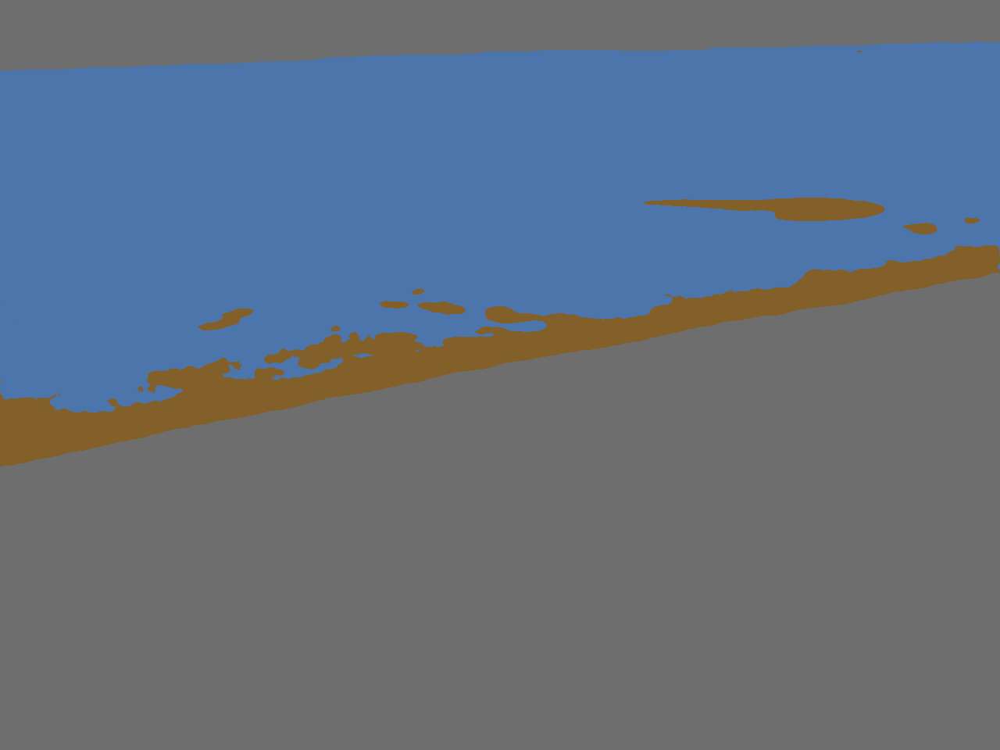

Imagen 5 procesada.



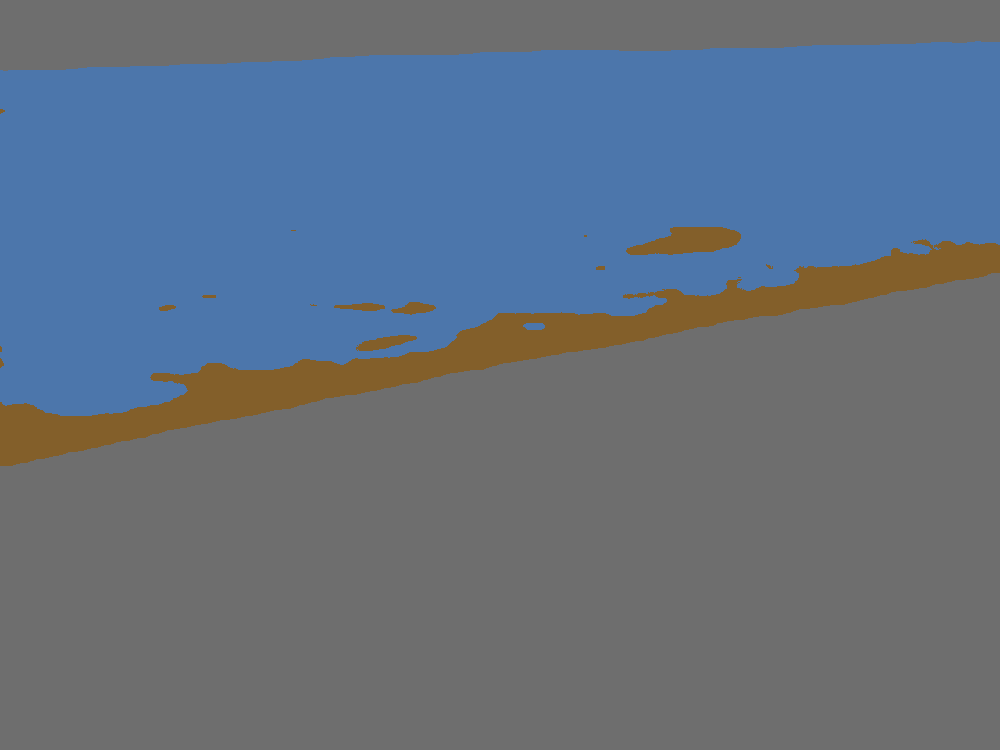

Imagen 6 procesada.



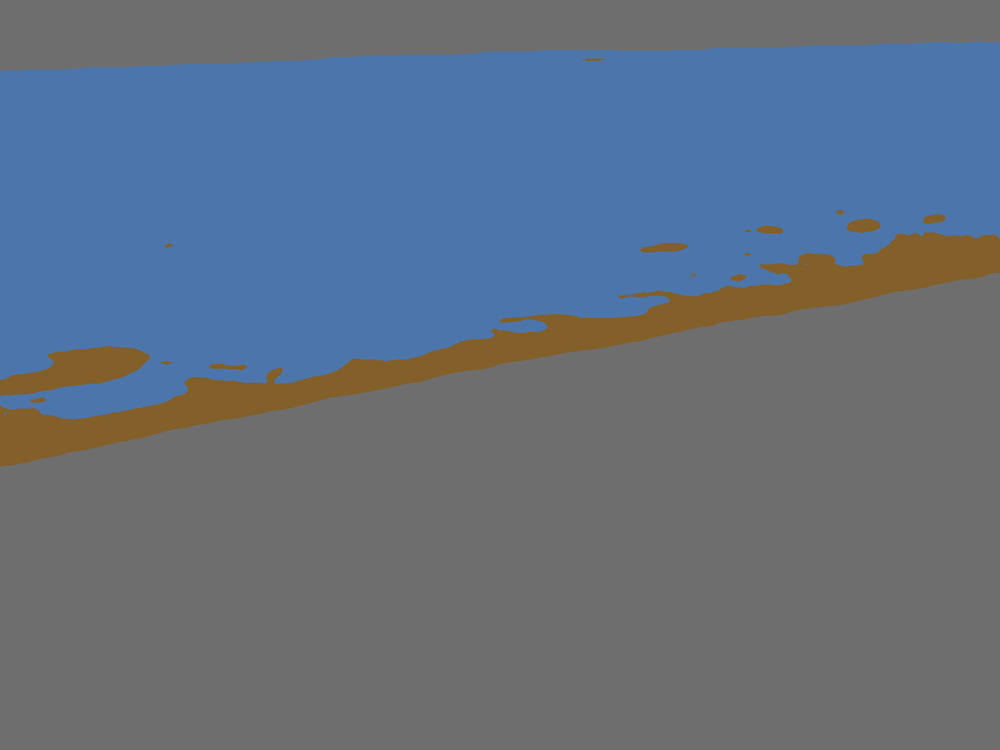

Imagen 7 procesada.



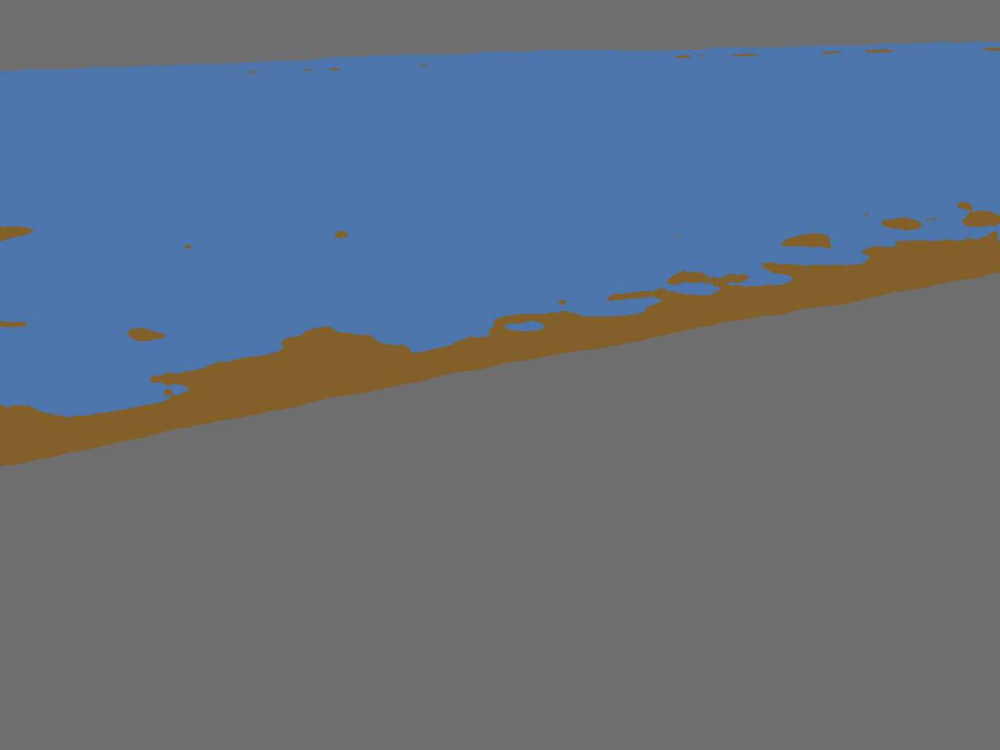

Imagen 8 procesada.



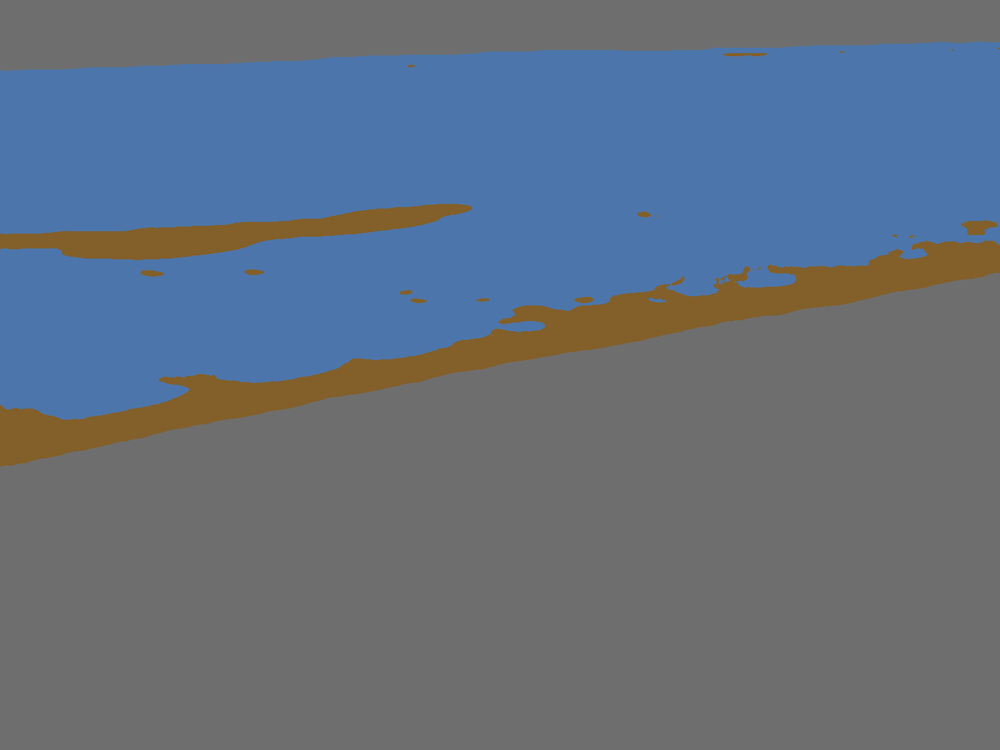

Imagen 9 procesada.



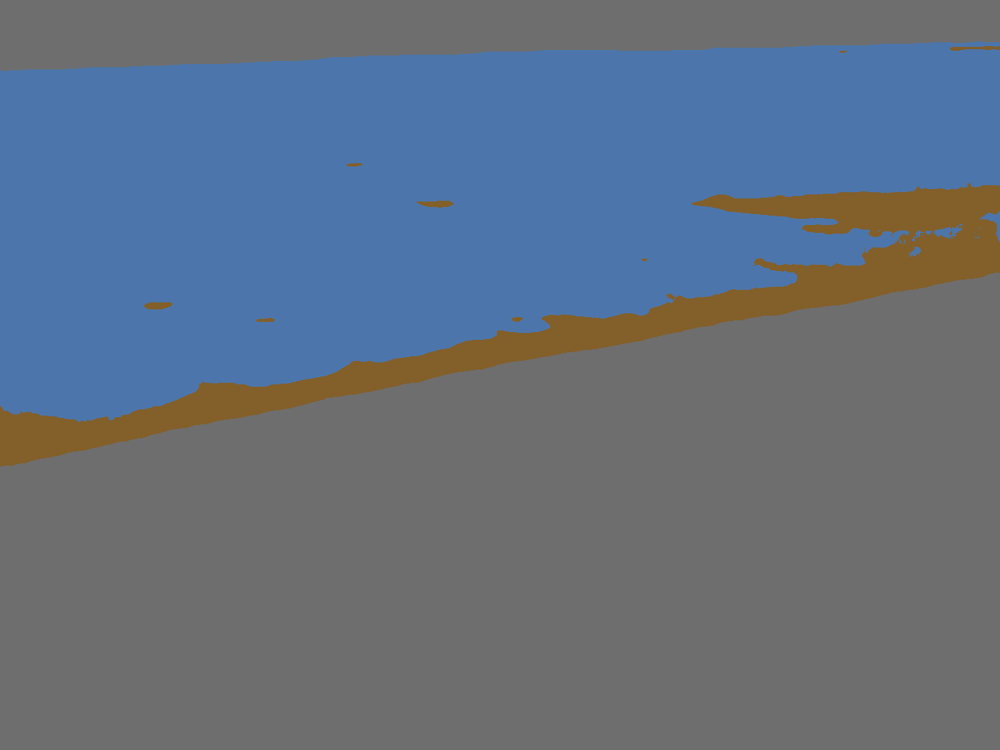

Imagen 10 procesada.



In [ ]:
results = []
test_images_filtered = applyFilters(test_images_list)
test_images_preprocessed = maskSustitution(test_images_filtered, initial_mask)

for i in range(0, len(test_images_preprocessed)):
  currImage = Image.fromarray(test_images_preprocessed[i])
  result = regions(classes, currImage, colours)
  result = cv2.cvtColor(np.array(result), cv2.COLOR_RGB2BGR)
  result = cv2.cvtColor(result, cv2.COLOR_BGR2RGB)
  cv2_imshow(cv2.cvtColor(result, cv2.COLOR_RGB2BGR))
  results.append(result)
  print("Imagen", i + 1, "procesada.\n")

#8. Cuantification and results

Se cuentan el número de píxeles totales (es el mismo para todas las imágenes), de sargazo, de océano y de fondo. Se muestran estos totales, además del porcentaje de píxeles de sargazo respecto al total y al océano. Adicionalmente, se muestran el porcentaje de píxeles de océano y de fondo con respecto al total (estos dos sumados junto con el porcentaje de píxeles de sargazo respecto al total siempre es 100%). Los porcentajes se muestran redondeados a dos decimales.

Además, se muestran lado a lado las imágenes de prueba originales y su resultado clasificado.

In [ ]:
sample = cv2.cvtColor(np.array(results[0]), cv2.COLOR_RGB2BGR)
sample = cv2.cvtColor(sample, cv2.COLOR_BGR2RGB)
total_pixels = sample.shape[0] * sample.shape[1]

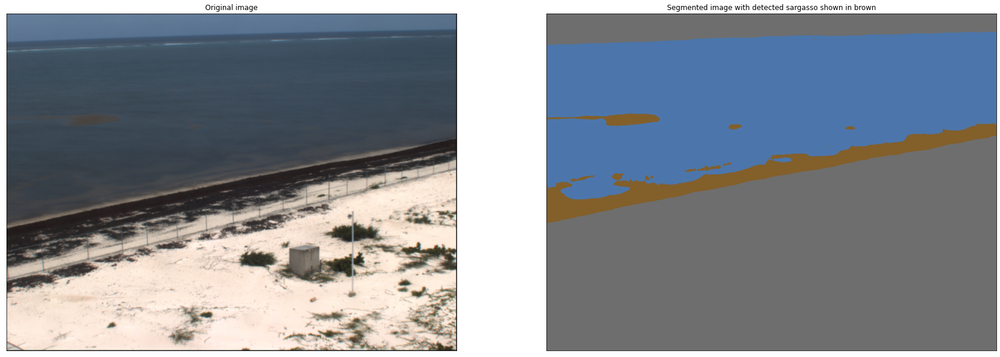

Total pixels: 1228800
Total sargasso pixels: 66290
Total ocean pixels: 446521
Sargasso pixels percentage in relation to total pixels: 5.39%
Sargasso pixels percentage in relation to ocean pixels: 14.85%

Ocean pixels percentage in relation to total pixels: 36.34%
Background pixels percentage in relation to total pixels: 58.27%




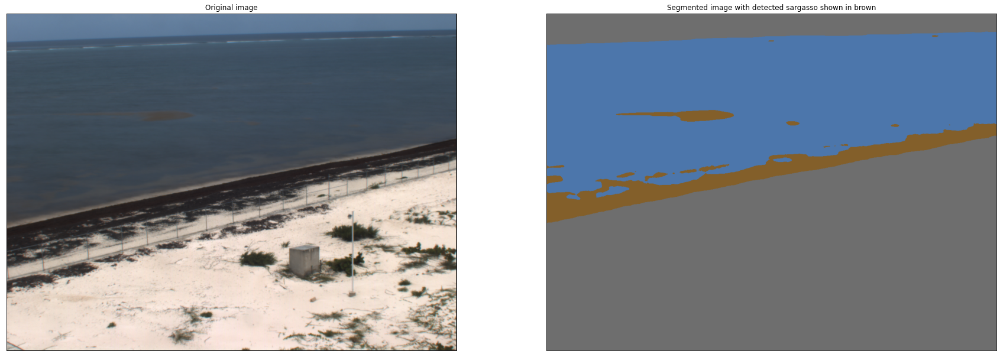

Total pixels: 1228800
Total sargasso pixels: 69415
Total ocean pixels: 443396
Sargasso pixels percentage in relation to total pixels: 5.65%
Sargasso pixels percentage in relation to ocean pixels: 15.66%

Ocean pixels percentage in relation to total pixels: 36.08%
Background pixels percentage in relation to total pixels: 58.27%




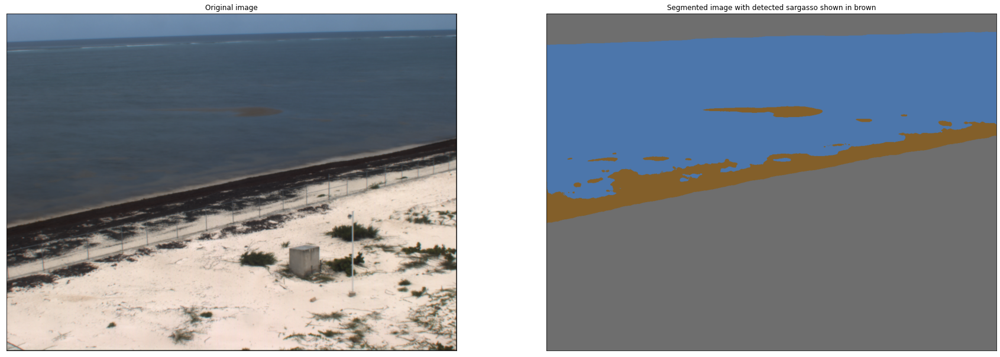

Total pixels: 1228800
Total sargasso pixels: 80023
Total ocean pixels: 432788
Sargasso pixels percentage in relation to total pixels: 6.51%
Sargasso pixels percentage in relation to ocean pixels: 18.49%

Ocean pixels percentage in relation to total pixels: 35.22%
Background pixels percentage in relation to total pixels: 58.27%




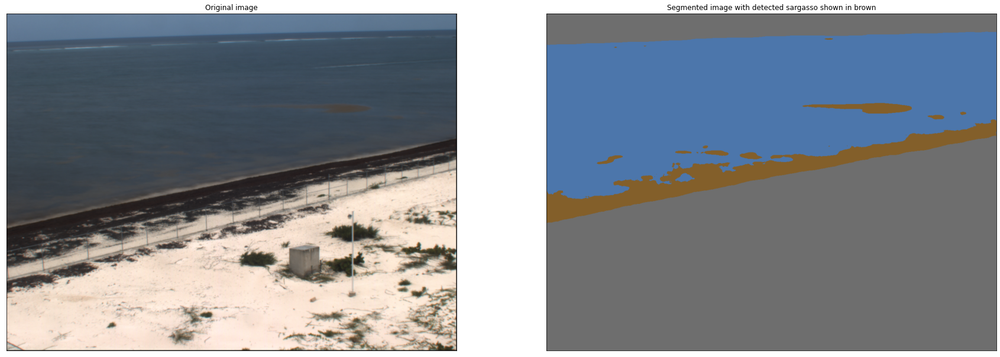

Total pixels: 1228800
Total sargasso pixels: 73554
Total ocean pixels: 439257
Sargasso pixels percentage in relation to total pixels: 5.99%
Sargasso pixels percentage in relation to ocean pixels: 16.75%

Ocean pixels percentage in relation to total pixels: 35.75%
Background pixels percentage in relation to total pixels: 58.27%




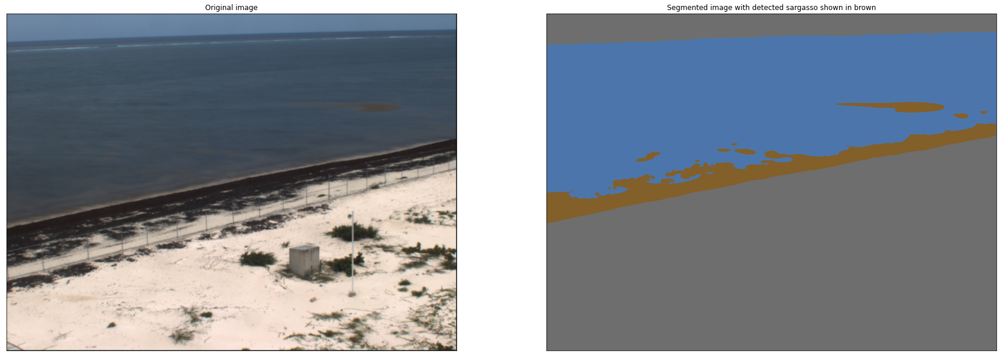

Total pixels: 1228800
Total sargasso pixels: 72993
Total ocean pixels: 439818
Sargasso pixels percentage in relation to total pixels: 5.94%
Sargasso pixels percentage in relation to ocean pixels: 16.6%

Ocean pixels percentage in relation to total pixels: 35.79%
Background pixels percentage in relation to total pixels: 58.27%




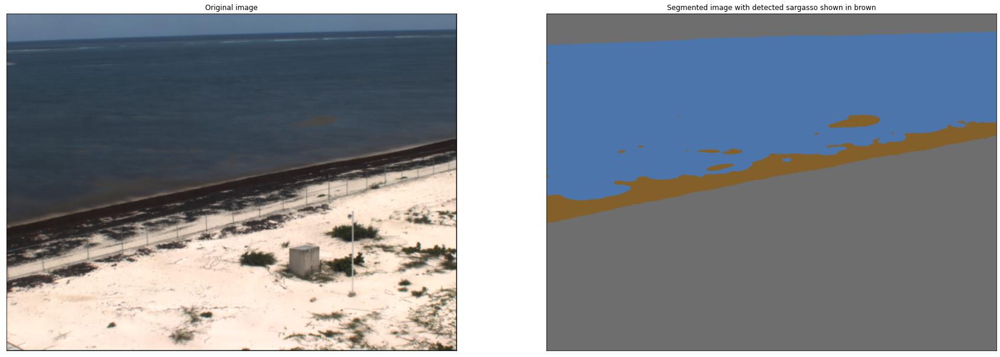

Total pixels: 1228800
Total sargasso pixels: 68877
Total ocean pixels: 443934
Sargasso pixels percentage in relation to total pixels: 5.61%
Sargasso pixels percentage in relation to ocean pixels: 15.52%

Ocean pixels percentage in relation to total pixels: 36.13%
Background pixels percentage in relation to total pixels: 58.27%




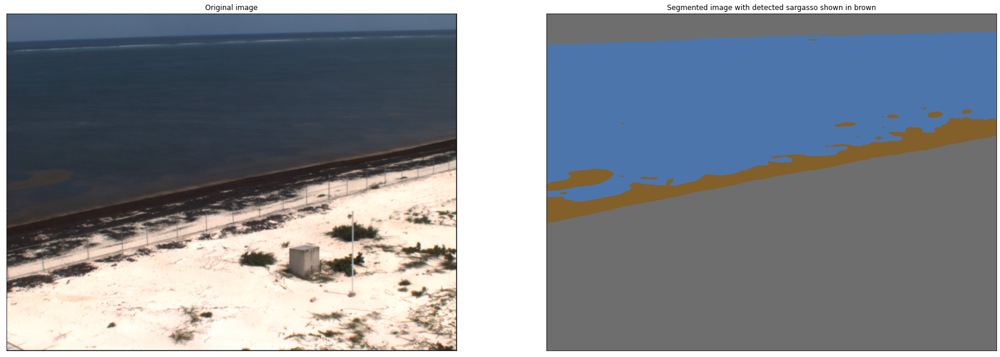

Total pixels: 1228800
Total sargasso pixels: 69127
Total ocean pixels: 443684
Sargasso pixels percentage in relation to total pixels: 5.63%
Sargasso pixels percentage in relation to ocean pixels: 15.58%

Ocean pixels percentage in relation to total pixels: 36.11%
Background pixels percentage in relation to total pixels: 58.27%




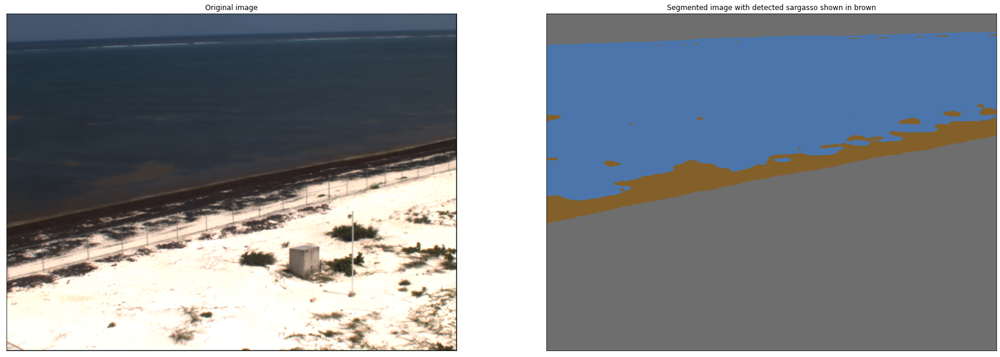

Total pixels: 1228800
Total sargasso pixels: 77142
Total ocean pixels: 435669
Sargasso pixels percentage in relation to total pixels: 6.28%
Sargasso pixels percentage in relation to ocean pixels: 17.71%

Ocean pixels percentage in relation to total pixels: 35.45%
Background pixels percentage in relation to total pixels: 58.27%




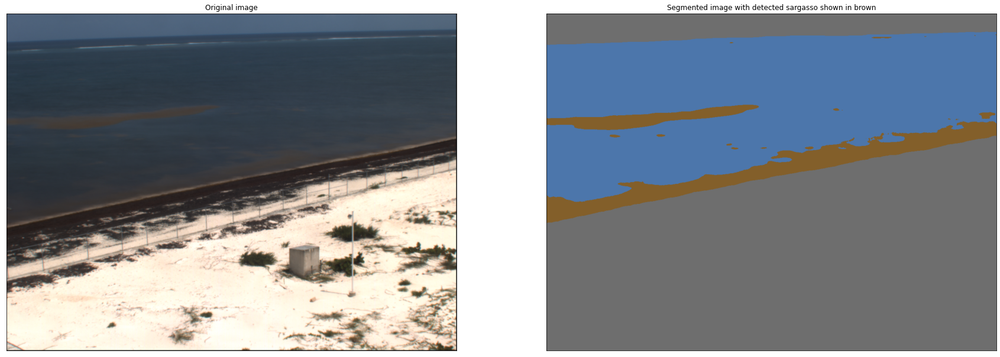

Total pixels: 1228800
Total sargasso pixels: 80127
Total ocean pixels: 432684
Sargasso pixels percentage in relation to total pixels: 6.52%
Sargasso pixels percentage in relation to ocean pixels: 18.52%

Ocean pixels percentage in relation to total pixels: 35.21%
Background pixels percentage in relation to total pixels: 58.27%




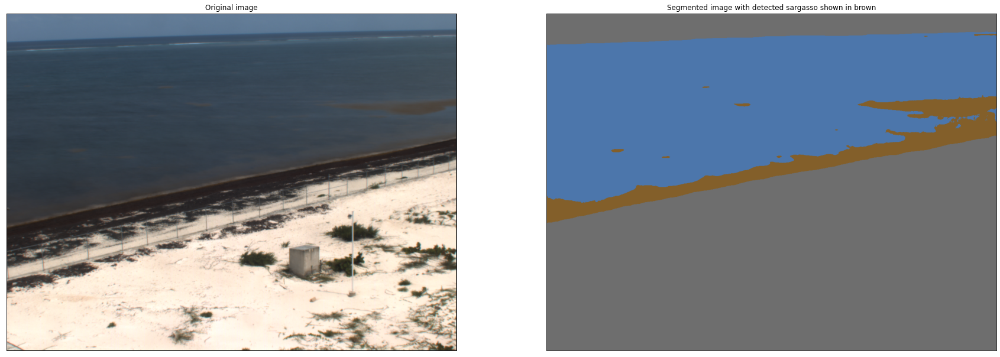

Total pixels: 1228800
Total sargasso pixels: 72692
Total ocean pixels: 440119
Sargasso pixels percentage in relation to total pixels: 5.92%
Sargasso pixels percentage in relation to ocean pixels: 16.52%

Ocean pixels percentage in relation to total pixels: 35.82%
Background pixels percentage in relation to total pixels: 58.27%




In [ ]:
resimg_idx = 0

for img in results:
  image = cv2.cvtColor(np.array(img), cv2.COLOR_RGB2BGR)
  image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
  # Gives back the indexes for each RGB value that matches RGB values defined to classify ocean, so we divide any group of indexes by 3 (R, G, B) to get pixels
  ocean_pixels = int(len(np.nonzero(image == [76, 118, 171])[0]) / 3)
  sargasso_pixels = int(len(np.nonzero(image == [131, 95, 42])[0]) / 3)
  background_pixels = int(len(np.nonzero(image == [110, 110, 110])[0]) / 3)
  orig_image = Image.open(test_images_list[resimg_idx])
  orig_image = cv2.cvtColor(np.array(orig_image), cv2.COLOR_RGB2BGR)
  orig_image = cv2.cvtColor(orig_image, cv2.COLOR_BGR2RGB)
  figure_size = 30
  plt.figure(figsize=(figure_size, figure_size))
  plt.subplot(1,2,1),plt.imshow(orig_image)
  plt.title("Original image"), plt.xticks([]), plt.yticks([])
  plt.subplot(1,2,2), plt.imshow(image)
  plt.title("Segmented image with detected sargasso shown in brown"), plt.xticks([]), plt.yticks([])
  plt.show()
  print("Total pixels: " + str(total_pixels))
  print("Total sargasso pixels: " + str(sargasso_pixels))
  print("Total ocean pixels: " + str(ocean_pixels))
  print("Sargasso pixels percentage in relation to total pixels: " + str(round((sargasso_pixels * 100 / total_pixels), 2)) + "%")
  print("Sargasso pixels percentage in relation to ocean pixels: " + str(round((sargasso_pixels * 100 / ocean_pixels), 2)) + "%")
  print("\nOcean pixels percentage in relation to total pixels: " + str(round((ocean_pixels * 100 / total_pixels), 2)) + "%")
  print("Background pixels percentage in relation to total pixels: " + str(round((background_pixels * 100 / total_pixels), 2)) + "%\n\n")
  resimg_idx += 1